# P07A DeepDown Comparison

@author: Midhun Murukesh (midhunmachari@gmail.com)

* Date: 14 November 2024

### Common Utilities

In [1]:
# Define other utility functions

def create_directory(directory_path):
    if not os.path.exists(directory_path):
        os.makedirs(directory_path)
        print(f"Directory '{directory_path}' created.")
    else:
        print(f"Directory '{directory_path}' already exists.")

In [2]:
SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
DATA_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/GENDATA"

In [123]:
!conda env list

Error while loading conda entry point: conda-libmamba-solver (libarchive.so.19: cannot open shared object file: No such file or directory)
# conda environments:
#
base                     /home/midhunm/miniconda3
cdo                   *  /home/midhunm/miniconda3/envs/cdo
jnv                      /home/midhunm/miniconda3/envs/jnv
tf2                      /home/midhunm/miniconda3/envs/tf2
tf_214                   /home/midhunm/miniconda3/envs/tf_214



## Figure 01 - Study Area

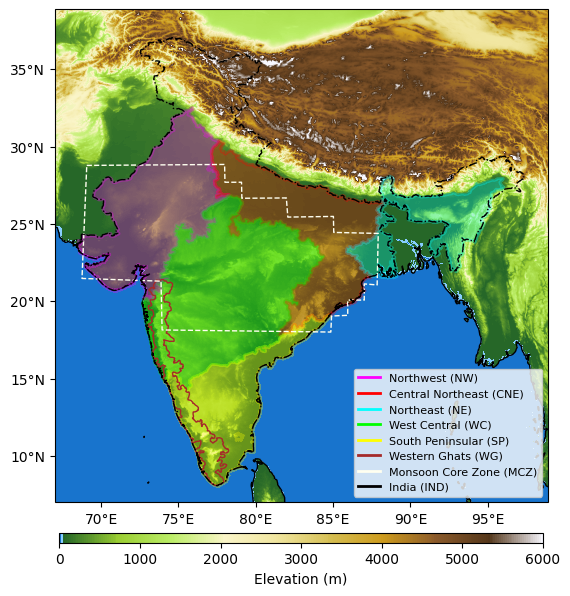

In [108]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.io.shapereader as shpreader
import xarray as xr
import geopandas as gpd
import cmaps
from cartopy.mpl.gridliner import LongitudeFormatter, LatitudeFormatter

SHAPE_PATH = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES'
DPATH = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA'

## Smart City Locations
city_loc = pd.read_csv(f'{DPATH}/India_Smart_Cities_Selected_12.csv')

## Load orography data
ds = xr.open_dataset(f'{DPATH}/IND_GTOPO30_30ARCSEC_50r.nc')
orog = ds['z']

# Get latitude and longitude coordinates from xarray dataset
lats = ds['lat']
lons = ds['lon']

# Define plot extent
lat_range = (ds.lat.data.min(), ds.lat.data.max())
lon_range = (ds.lon.data.min(), ds.lon.data.max())

# Create figure and axis objects
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

# Plot orography data with inverted y-axis
im = ax.imshow(orog, 
               cmap=cmaps.OceanLakeLandSnow,
               alpha=1.0, vmin=0, vmax=6000,
               extent=[lon_range[0], lon_range[1], lat_range[1], lat_range[0]], 
               origin='upper', 
               transform=ccrs.PlateCarree())

# Add coastlines and colorbar
ax.coastlines(resolution='50m')
cbar = plt.colorbar(im, orientation='horizontal', pad=0.05, aspect=50, shrink=0.78)
cbar.set_label('Elevation (m)')

# Overlay other shapefiles
india_subzones = [   
    {'shapefile': 'Northwest.shp', 
     'label': 'Northwest (NW)', 
     'linestyle': '-', 
     'color': 'magenta'
    }, 
    
    {'shapefile': 'Central_Northeast.shp', 
     'label': 'Central Northeast (CNE)', 
     'linestyle': '-',
     'color': 'red'
    }, 
    
    {'shapefile': 'Northeast.shp', 
     'label': 'Northeast (NE)', 
     'linestyle': '-', 
     'color': 'cyan'
    },
    
    {'shapefile': 'West_Central.shp', 
     'label': 'West Central (WC)', 
     'linestyle': '-', 
     'color': 'lime'
    },
    
    {'shapefile': 'South_Peninsular.shp', 
     'label': 'South Peninsular (SP)', 
     'linestyle': '-', 
     'color': 'yellow'
    },

    {'shapefile': 'Western_Ghats.shp', 
     'label': 'Western Ghats (WG)', 
     'linestyle': '-', 
     'color': 'brown'
    },

    {'shapefile': 'Monsoon_Core_Zone.shp', 
     'label': 'Monsoon Core Zone (MCZ)', 
     'linestyle': '--', 
     'color': 'ivory'
    },
    
    {'shapefile': 'India.shp', 
     'label': 'India (IND)', 
     'linestyle': '-.', 
     'color': 'k'
    },    

    # {'shapefile': 'Himalaya.shp', 
    #  'label': 'Himalayas (HIM)', 
    #  'linestyle': '-', 
    #  'color': 'blue'
    # },
    
    # {'shapefile': 'Hilly_Regions.shp', 
    #  'label': 'Hilly Regions (HR)', 
    #  'linestyle': '-', 
    #  'color': 'blue'
    # },
    
]

for region in india_subzones:
    geometries = gpd.read_file(f'{SHAPE_PATH}/{region["shapefile"]}')['geometry']
    for geometry in geometries:
        if region['label'] in ['Himalayas (HIM)', 'Northwest (NW)', 'Central Northeast (CNE)', 
                               'Northeast (NE)', 'West Central (WC)', 'South Peninsular (SP)', 'Hilly Regions (HR)']:
            ax.add_geometries([geometry], ccrs.PlateCarree(), 
                              facecolor= region['color'], 
                              edgecolor=region['color'], linewidth=2, linestyle=region['linestyle'], 
                              alpha=0.3)
        else:
            ax.add_geometries([geometry], ccrs.PlateCarree(), 
                              facecolor='none', 
                              edgecolor=region['color'], linewidth=1, linestyle=region['linestyle'])
    ax.plot([], [], color=region['color'], label=region['label'], linewidth=2)

# # Plot Smart City Locations
# ax.scatter(city_loc['Longitude'], city_loc['Latitude'], 
#            color='red', s=120, marker='*', 
#            transform=ccrs.PlateCarree(), 
#            edgecolor='black', linewidth=1, zorder=10, label='Selected Cities')

ax.invert_yaxis()

# Add a legend
legend = ax.legend(loc='lower right', fontsize=8)

# Add latitude and longitude ticks
ax.set_xticks(np.arange(70, 99, 5), crs=ccrs.PlateCarree())
ax.set_yticks(np.arange(10, 38, 5), crs=ccrs.PlateCarree())
lon_formatter = LongitudeFormatter(zero_direction_label=False)
lat_formatter = LatitudeFormatter()
ax.xaxis.set_major_formatter(lon_formatter)
ax.yaxis.set_major_formatter(lat_formatter)

# SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{SAVE_PATH}/Figure01_Elevation_Map_with_SmartCities.png', 
#             format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')
# plt.show()


## Figure 02 - Plot Training Times

In [1]:
import matplotlib.pyplot as plt
import pandas as pd

# Load data
df = pd.read_csv("/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/P07A_CALC_MES.csv")

# Define color palette
colors = [
    "#ff7f0e",  # Orange
    "#bcbd22",  # Yellow-green
    "#2ca02c",  # Green
    "#e377c2",  # Pink
    "#8c564b",  # Brown
    "#9467bd",  # Purple
    "#17becf",  # Teal
    "#1f77b4",  # Blue
]

# Plotting
fig, axs = plt.subplots(3, 1, figsize=(18, 14), sharex=True)

# Epochs till Convergence Bar Plot
axs[0].bar(df["MODEL_NAME"], df["EPOCH_TILL_CONVERGENCE"], color=colors[:len(df)])
axs[0].set_ylabel("EPOCHS", fontsize=20, fontweight="bold")
axs[0].set_title("EPOCHS TILL CONVERGENCE", fontsize=23, fontweight="normal")
axs[0].tick_params(axis='y', labelsize=20)
axs[0].set_ylim(0,240)

# Display values close to each bar
for i, value in enumerate(df["EPOCH_TILL_CONVERGENCE"]):
    axs[0].text(i, value + 0.5, f'{value}', ha='center', va='bottom', fontsize=25, fontweight='normal')
    

# Training Time per Epoch Bar Plot
axs[1].bar(df["MODEL_NAME"], df["TRAINING_TIME_MIN"], color=colors[:len(df)])
axs[1].set_ylabel("TRAINING TIME (min)", fontsize=20, fontweight="bold")
axs[1].set_title("TOTAL TRAINING TIME", fontsize=23, fontweight="normal")
axs[1].tick_params(axis='y', labelsize=20)
axs[1].set_ylim(0, 130)

# Display values close to each bar
for i, value in enumerate(df["TRAINING_TIME_MIN"]):
    axs[1].text(i, value + 0.5, f'{value:.0f}', ha='center', va='bottom', fontsize=25, fontweight='normal')



# Inference Time Bar Plot
axs[2].bar(df["MODEL_NAME"], df["INFERENCE_TIME"], color=colors[:len(df)])
axs[2].set_ylabel("INFERENCE TIME (sec)", fontsize=20, fontweight="bold")
# axs[2].set_xlabel("Model", fontsize=14, fontweight="bold")
axs[2].set_title("INFERENCE TIME TO GENERATE 1 YEAR DATA", fontsize=23, fontweight="normal",)
axs[2].tick_params(axis='y', labelsize=20)
axs[2].tick_params(axis='x', labelsize=25,)
axs[2].set_ylim(0,110)

# Display values close to each bar
for i, value in enumerate(df["INFERENCE_TIME"]):
    axs[2].text(i, value + 0.5, f'{value:.2f}', ha='center', va='bottom', fontsize=25, fontweight='normal')

# Adjust layout and show plot
plt.tight_layout()

# Add labels for each subplot
mark_list = ['(a)', '(b)', '(c)']
for i, mark in enumerate(mark_list):
    axs[i].text(0.02, 0.85, mark, transform=axs[i].transAxes, fontsize=30, color='k', fontweight='bold')

# SAVE_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{SAVE_PATH}/Figure03_Training_Time.png', format='png', dpi=600, bbox_inches='tight', facecolor='w', edgecolor='w')

plt.show()

FileNotFoundError: [Errno 2] No such file or directory: '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/P07A_CALC_MES.csv'

## Figure: Spatial Map of Evaluation Metrics - BIAS SDII

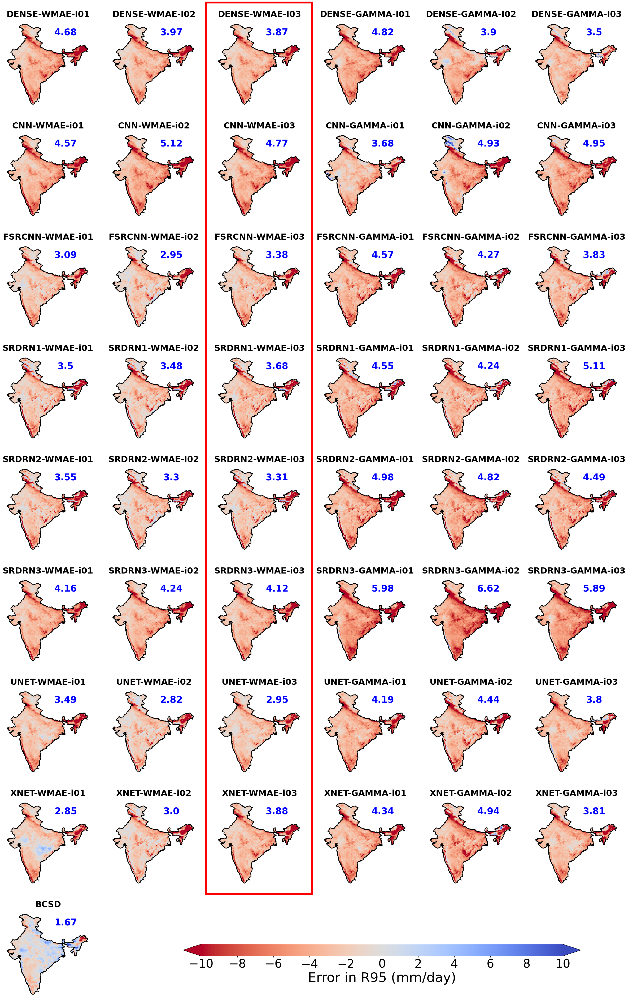

In [50]:
## Masked spatial plots
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import geopandas as gpd
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.patches import PathPatch
import cmaps
from shapely.geometry import box
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches

#################### Calculate metric value ####################

def abs_mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(abs(arr))
    return arr

def mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(arr)
    return arr

def create_axes(nrows, ncols, figsize=(13,13), hspace=None, wspace=None):
    
    # Create figure and axis objects
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace) #  , wspace=wspace hspace=0.5, wspace=0

    # Create subplots with specific projection using GridSpec
    axes = []
    for i in range(nrows):
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            axes.append(ax)
    # fig.tight_layout()

    # fig.tight_layout(pad=0) 
    # plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    return fig, axes

def get_lon_lat(ds, data_var):
    """
    Extract longitude and latitude values from 
    xarray array and variable name
    """
    
    data_coords = ds[data_var].coords
    lon_var, lat_var = None, None

    for coord_name, coord_var in data_coords.items():
        if 'longitude' in coord_var.standard_name or 'lon' in coord_var.standard_name:
            lon_var = coord_var
        elif 'latitude' in coord_var.standard_name or 'lat' in coord_var.standard_name:
            lat_var = coord_var

    return lon_var, lat_var

def filter_df(df, column, string):
    """ Select and merge rows from the dataframe where the specified string is present in the specified column""" 
    filtered_df = df[df[column].str.contains(string, na=False)]
    return filtered_df

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict('list')

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def my_custom_subplot(ax, ds, lonlat, cmap, vmin, vmax, 
                      title=None, ylabel=None, 
                      text=None, text_loc=None, 
                      overlay_pval=False, pval_data=None, 
                     ):
    
    # Plot data ds1 with inverted y-axis
    im = ax.imshow(ds, 
                   cmap=cmap, 
                   alpha=1.0, 
                   vmin=vmin, 
                   vmax=vmax,
                   extent=[lonlat[0].data.min(), 
                           lonlat[0].data.max(),
                           lonlat[1].data.max(),
                           lonlat[1].data.min()], 
                   origin='upper', 
                   transform=ccrs.PlateCarree()
                  )
    # ---------------
    # Add coastlines
    # ---------------
    # ax.coastlines(resolution='50m')
    ax.invert_yaxis()
    
    # --------------------
    # Add India shapefile
    # --------------------
    shapefile_path = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES/India.shp"         
    shapefile_df = gpd.read_file(shapefile_path)
    countries = shapefile_df['geometry']
    ax.add_geometries(countries, ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=2)

    # -----------------------
    # Overlay pvalue hatches 
    # -----------------------
    if overlay_pval:

        if pval_data is None:
            raise ValueError('You have asked to plot pval stipples, but no data passed.')
        else:
            significance_threshold = 0.01
            significant_mask = pval_data <= significance_threshold
        

    
        # Overlay hatched polygons for significant correlations
        bbox = box(lonlat[0].data.min(), lonlat[1].data.min(), lonlat[0].data.max(), lonlat[1].data.max())
        for geom in countries:
            if bbox.intersects(geom):
                masked_geom = geom.intersection(bbox)
                if masked_geom.is_empty:
                    continue   
                if significant_mask.sel(longitude=slice(masked_geom.bounds[0], masked_geom.bounds[2]),
                                         latitude=slice(masked_geom.bounds[1], masked_geom.bounds[3])).any():
                    ax.add_geometries([masked_geom], 
                                      ccrs.PlateCarree(), 
                                      facecolor='none', 
                                      edgecolor='k', 
                                      hatch='.', 
                                      linewidth=1)
                    continue
    
    # -------------------------
    # Add text inside the plot
    # -------------------------
    if text is not None:
        ax.text(text_loc[0], text_loc[1], 
                text, 
                transform=ax.transAxes, ha='center', va='center', 
                fontsize=25, fontweight='bold', 
                color='blue', backgroundcolor=None, bbox=None)

    # ------------------------------
    # Additional plot customization
    # ------------------------------
    ax.set_title(title, loc='center', fontsize=23, fontweight='semibold')
    ax.set_ylabel(ylabel, loc='center', fontsize=22, fontweight='semibold')
    ax.set_xticks(np.arange(70, 100, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(10, 40, 5), crs=ccrs.PlateCarree())
    lon_formatter = LongitudeFormatter(zero_direction_label=False)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.tick_params(axis="both", labelsize=12)

    ax.set_axis_off()
    
    return im


#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

# Create axes for subplots and set lonlat limits
fig, axes = create_axes(nrows=9, ncols=6, figsize=(30,45), hspace=0.1, wspace=None)
lon_l, lat_l = (70, 98, 5), (10, 38, 5)

# Load datafiles
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
d = xr.open_dataset(f'{DPATH}/P07A_EVAL_METRICS_BIAS_R95_v1.nc')
df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")

m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES/India.nc')

varname = 'BIAS_R95'
cbar_label = 'Error in R95 (mm/day)'

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
df = filter_df(df, column='ZONE_NAME', string="INDIA")
# df = filter_df(df, column='EXP_ID', string="L01")

exp_dict = df_to_dict(df, key_col="EXP_ID", value_cols=["LABEL", "PBIAS"])

# if 'C01' in exp_dict:
#     del exp_dict['C01']  # This will safely remove 'b' without changing the dictionary to a lis

#-----------------------------------------------------------------------
############################# Edit below ###############################
#-----------------------------------------------------------------------

cmap = 'coolwarm_r' #cmaps.GMT_panoply
vmin, vmax, inc = -10, 10, 2



for i, (exp_id, (title, metric_val)) in enumerate(exp_dict.items()):
    
    my_var = f'{exp_id}_{varname}' if exp_id=="C01" else f'{exp_id}_B01_R01_{varname}'
    ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
    im = my_custom_subplot(ax=axes[i], 
                    ds=ds_f,
                    lonlat=get_lon_lat(d, my_var), 
                    cmap=cmap, vmin=vmin, vmax=vmax,
                    text=abs_mean(ds_f.data).round(2), #round(metric_val, 3), #mean(d[my_var][:].data).round(4),
                    text_loc=[0.7, 0.85],
                    ylabel=None,
                    title=title,
                    overlay_pval=False,
                    pval_data = None, #d[f'{exp_id}_TSTAT_PVAL'],
                    )
    
#----------------------------------------------------
# Add the rectangular box to the Figure object
#----------------------------------------------------

# Calculate the rectangle position and size to cover the third column
x = axes[2].get_position().xmin - 0.012 # x position of the third column
y = axes[44].get_position().ymin  - 0.057  # Shift down by decreasing y position
width = axes[2].get_position().width * 1.2  # width of the third column subplot
height = (axes[2].get_position().ymax  * 1.1) - (axes[44].get_position().ymin * 1.1)  # total height of the third column

# Add the rectangle to the figure using fig.patches
rect = patches.Rectangle((x, y), width, height, linewidth=5, edgecolor='r', facecolor='none', transform=fig.transFigure)
fig.patches.append(rect)  # Add patch to fig.patches

#----------------------------------------------------
# Uncomment below code snippet to set horizontal cbar 
#----------------------------------------------------

fig.subplots_adjust(bottom=0.05)
cbar_ax = fig.add_axes([0.35, 0.09, 0.5, 0.01])
cb = fig.colorbar(im, cax=cbar_ax, 
                  ticks=np.arange(vmin, vmax+inc, inc), 
                  orientation="horizontal", 
                  extend='both')
cb.ax.tick_params(labelsize=32)
cb.set_label(cbar_label, 
             rotation = 0, 
             fontsize = 36, 
             fontweight='normal') 

for ax in axes[-5:]:
    ax.axis('off')

SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'
# plt.savefig(f'{SAVE_DIR}/Figure_SpatialMap_{varname.upper()}.png', format='png', dpi=400, bbox_inches='tight',facecolor='w', edgecolor='w')
plt.show()



## Figure: Spatial Map of Evaluation Metrics - PBIAS

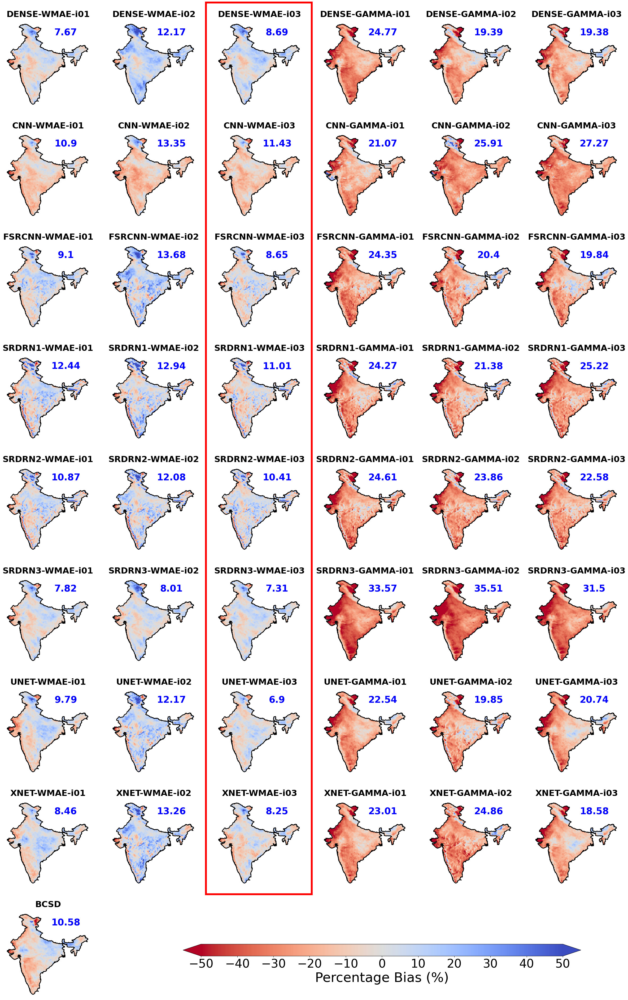

In [316]:
## Masked spatial plots
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import geopandas as gpd
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.patches import PathPatch
import cmaps
from shapely.geometry import box
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches

#################### Calculate metric value ####################

def abs_mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(abs(arr))
    return arr

def mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(arr)
    return arr

def create_axes(nrows, ncols, figsize=(13,13), hspace=None, wspace=None):
    
    # Create figure and axis objects
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace) #  , wspace=wspace hspace=0.5, wspace=0

    # Create subplots with specific projection using GridSpec
    axes = []
    for i in range(nrows):
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            axes.append(ax)
    # fig.tight_layout()

    # fig.tight_layout(pad=0) 
    # plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    return fig, axes

def get_lon_lat(ds, data_var):
    """
    Extract longitude and latitude values from 
    xarray array and variable name
    """
    
    data_coords = ds[data_var].coords
    lon_var, lat_var = None, None

    for coord_name, coord_var in data_coords.items():
        if 'longitude' in coord_var.standard_name or 'lon' in coord_var.standard_name:
            lon_var = coord_var
        elif 'latitude' in coord_var.standard_name or 'lat' in coord_var.standard_name:
            lat_var = coord_var

    return lon_var, lat_var

def filter_df(df, column, string):
    """ Select and merge rows from the dataframe where the specified string is present in the specified column""" 
    filtered_df = df[df[column].str.contains(string, na=False)]
    return filtered_df

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict('list')

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def my_custom_subplot(ax, ds, lonlat, cmap, vmin, vmax, 
                      title=None, ylabel=None, 
                      text=None, text_loc=None, 
                      overlay_pval=False, pval_data=None, 
                     ):
    
    # Plot data ds1 with inverted y-axis
    im = ax.imshow(ds, 
                   cmap=cmap, 
                   alpha=1.0, 
                   vmin=vmin, 
                   vmax=vmax,
                   extent=[lonlat[0].data.min(), 
                           lonlat[0].data.max(),
                           lonlat[1].data.max(),
                           lonlat[1].data.min()], 
                   origin='upper', 
                   transform=ccrs.PlateCarree()
                  )
    # ---------------
    # Add coastlines
    # ---------------
    # ax.coastlines(resolution='50m')
    ax.invert_yaxis()
    
    # --------------------
    # Add India shapefile
    # --------------------
    shapefile_path = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES/India.shp"         
    shapefile_df = gpd.read_file(shapefile_path)
    countries = shapefile_df['geometry']
    ax.add_geometries(countries, ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=2)

    # -----------------------
    # Overlay pvalue hatches 
    # -----------------------
    if overlay_pval:

        if pval_data is None:
            raise ValueError('You have asked to plot pval stipples, but no data passed.')
        else:
            significance_threshold = 0.01
            significant_mask = pval_data <= significance_threshold
        

    
        # Overlay hatched polygons for significant correlations
        bbox = box(lonlat[0].data.min(), lonlat[1].data.min(), lonlat[0].data.max(), lonlat[1].data.max())
        for geom in countries:
            if bbox.intersects(geom):
                masked_geom = geom.intersection(bbox)
                if masked_geom.is_empty:
                    continue   
                if significant_mask.sel(longitude=slice(masked_geom.bounds[0], masked_geom.bounds[2]),
                                         latitude=slice(masked_geom.bounds[1], masked_geom.bounds[3])).any():
                    ax.add_geometries([masked_geom], 
                                      ccrs.PlateCarree(), 
                                      facecolor='none', 
                                      edgecolor='k', 
                                      hatch='.', 
                                      linewidth=1)
                    continue
    
    # -------------------------
    # Add text inside the plot
    # -------------------------
    if text is not None:
        ax.text(text_loc[0], text_loc[1], 
                text, 
                transform=ax.transAxes, ha='center', va='center', 
                fontsize=25, fontweight='bold', 
                color='blue', backgroundcolor=None, bbox=None)

    # ------------------------------
    # Additional plot customization
    # ------------------------------
    ax.set_title(title, loc='center', fontsize=23, fontweight='semibold')
    ax.set_ylabel(ylabel, loc='center', fontsize=22, fontweight='semibold')
    ax.set_xticks(np.arange(70, 100, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(10, 40, 5), crs=ccrs.PlateCarree())
    lon_formatter = LongitudeFormatter(zero_direction_label=False)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.tick_params(axis="both", labelsize=12)

    ax.set_axis_off()
    
    return im


#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

# Create axes for subplots and set lonlat limits
fig, axes = create_axes(nrows=9, ncols=6, figsize=(30,45), hspace=0.1, wspace=None)
lon_l, lat_l = (70, 98, 5), (10, 38, 5)

# Load datafiles
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
d = xr.open_dataset(f'{DPATH}/EVAL_METRICS_SPATIAL_v1.nc')
df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")

m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES/India.nc')

varname = 'PBIAS'
cbar_label = 'Percentage Bias (%)'

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
df = filter_df(df, column='ZONE_NAME', string="INDIA")
# df = filter_df(df, column='EXP_ID', string="L01")

exp_dict = df_to_dict(df, key_col="EXP_ID", value_cols=["LABEL", varname])

# if 'C01' in exp_dict:
#     del exp_dict['C01']  # This will safely remove 'b' without changing the dictionary to a lis

#-----------------------------------------------------------------------
############################# Edit below ###############################
#-----------------------------------------------------------------------

cmap = 'coolwarm_r' #cmaps.GMT_panoply
vmin, vmax, inc = -50, 50, 10



for i, (exp_id, (title, metric_val)) in enumerate(exp_dict.items()):
    
    my_var = f'{exp_id}_{varname}'
    ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
    im = my_custom_subplot(ax=axes[i], 
                    ds=ds_f,
                    lonlat=get_lon_lat(d, my_var), 
                    cmap=cmap, vmin=vmin, vmax=vmax,
                    text=abs_mean(ds_f.data).round(2), #round(metric_val, 3), #mean(d[my_var][:].data).round(4),
                    text_loc=[0.7, 0.85],
                    ylabel=None,
                    title=title,
                    overlay_pval=False,
                    pval_data = d[f'{exp_id}_TSTAT_PVAL'],
                    )
    
#----------------------------------------------------
# Add the rectangular box to the Figure object
#----------------------------------------------------

# Calculate the rectangle position and size to cover the third column
x = axes[2].get_position().xmin - 0.012 # x position of the third column
y = axes[44].get_position().ymin  - 0.057  # Shift down by decreasing y position
width = axes[2].get_position().width * 1.2  # width of the third column subplot
height = (axes[2].get_position().ymax  * 1.1) - (axes[44].get_position().ymin * 1.1)  # total height of the third column

# Add the rectangle to the figure using fig.patches
rect = patches.Rectangle((x, y), width, height, linewidth=5, edgecolor='r', facecolor='none', transform=fig.transFigure)
fig.patches.append(rect)  # Add patch to fig.patches

#----------------------------------------------------
# Uncomment below code snippet to set horizontal cbar 
#----------------------------------------------------

fig.subplots_adjust(bottom=0.05)
cbar_ax = fig.add_axes([0.35, 0.09, 0.5, 0.01])
cb = fig.colorbar(im, cax=cbar_ax, 
                  ticks=np.arange(vmin, vmax+inc, inc), 
                  orientation="horizontal", 
                  extend='both')
cb.ax.tick_params(labelsize=32)
cb.set_label(cbar_label, 
             rotation = 0, 
             fontsize = 36, 
             fontweight='normal') 

for ax in axes[-5:]:
    ax.axis('off')

SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'
# plt.savefig(f'{SAVE_DIR}/Figure_SpatialMap_{varname.upper()}.png', format='png', dpi=400, bbox_inches='tight',facecolor='w', edgecolor='w')
plt.show()



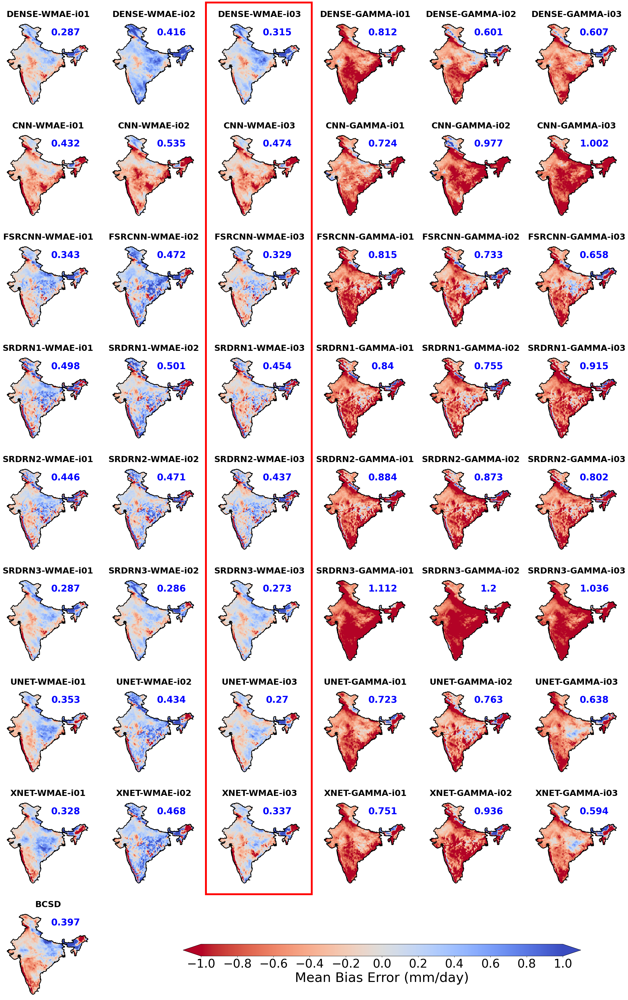

In [83]:
## Masked spatial plots
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import geopandas as gpd
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.patches import PathPatch
import cmaps
from shapely.geometry import box
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches

#################### Calculate metric value ####################

def abs_mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(abs(arr))
    return arr

def mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(arr)
    return arr

def create_axes(nrows, ncols, figsize=(13,13), hspace=None, wspace=None):
    
    # Create figure and axis objects
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace) #  , wspace=wspace hspace=0.5, wspace=0

    # Create subplots with specific projection using GridSpec
    axes = []
    for i in range(nrows):
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            axes.append(ax)
    # fig.tight_layout()

    # fig.tight_layout(pad=0) 
    # plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    return fig, axes

def get_lon_lat(ds, data_var):
    """
    Extract longitude and latitude values from 
    xarray array and variable name
    """
    
    data_coords = ds[data_var].coords
    lon_var, lat_var = None, None

    for coord_name, coord_var in data_coords.items():
        if 'longitude' in coord_var.standard_name or 'lon' in coord_var.standard_name:
            lon_var = coord_var
        elif 'latitude' in coord_var.standard_name or 'lat' in coord_var.standard_name:
            lat_var = coord_var

    return lon_var, lat_var

def filter_df(df, column, string):
    """ Select and merge rows from the dataframe where the specified string is present in the specified column""" 
    filtered_df = df[df[column].str.contains(string, na=False)]
    return filtered_df

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict('list')

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def my_custom_subplot(ax, ds, lonlat, cmap, vmin, vmax, 
                      title=None, ylabel=None, 
                      text=None, text_loc=None, 
                      overlay_pval=False, pval_data=None, 
                     ):
    
    # Plot data ds1 with inverted y-axis
    im = ax.imshow(ds, 
                   cmap=cmap, 
                   alpha=1.0, 
                   vmin=vmin, 
                   vmax=vmax,
                   extent=[lonlat[0].data.min(), 
                           lonlat[0].data.max(),
                           lonlat[1].data.max(),
                           lonlat[1].data.min()], 
                   origin='upper', 
                   transform=ccrs.PlateCarree()
                  )
    # ---------------
    # Add coastlines
    # ---------------
    # ax.coastlines(resolution='50m')
    ax.invert_yaxis()
    
    # --------------------
    # Add India shapefile
    # --------------------
    shapefile_path = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES/India.shp"         
    shapefile_df = gpd.read_file(shapefile_path)
    countries = shapefile_df['geometry']
    ax.add_geometries(countries, ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=2)

    # -----------------------
    # Overlay pvalue hatches 
    # -----------------------
    if overlay_pval:

        if pval_data is None:
            raise ValueError('You have asked to plot pval stipples, but no data passed.')
        else:
            significance_threshold = 0.01
            significant_mask = pval_data <= significance_threshold
        

    
        # Overlay hatched polygons for significant correlations
        bbox = box(lonlat[0].data.min(), lonlat[1].data.min(), lonlat[0].data.max(), lonlat[1].data.max())
        for geom in countries:
            if bbox.intersects(geom):
                masked_geom = geom.intersection(bbox)
                if masked_geom.is_empty:
                    continue   
                if significant_mask.sel(longitude=slice(masked_geom.bounds[0], masked_geom.bounds[2]),
                                         latitude=slice(masked_geom.bounds[1], masked_geom.bounds[3])).any():
                    ax.add_geometries([masked_geom], 
                                      ccrs.PlateCarree(), 
                                      facecolor='none', 
                                      edgecolor='k', 
                                      hatch='.', 
                                      linewidth=1)
                    continue
    
    # -------------------------
    # Add text inside the plot
    # -------------------------
    if text is not None:
        ax.text(text_loc[0], text_loc[1], 
                text, 
                transform=ax.transAxes, ha='center', va='center', 
                fontsize=25, fontweight='bold', 
                color='blue', backgroundcolor=None, bbox=None)

    # ------------------------------
    # Additional plot customization
    # ------------------------------
    ax.set_title(title, loc='center', fontsize=23, fontweight='semibold')
    ax.set_ylabel(ylabel, loc='center', fontsize=22, fontweight='semibold')
    ax.set_xticks(np.arange(70, 100, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(10, 40, 5), crs=ccrs.PlateCarree())
    lon_formatter = LongitudeFormatter(zero_direction_label=False)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.tick_params(axis="both", labelsize=12)

    ax.set_axis_off()
    
    return im


#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

# Create axes for subplots and set lonlat limits
fig, axes = create_axes(nrows=9, ncols=6, figsize=(30,45), hspace=0.1, wspace=None)
lon_l, lat_l = (70, 98, 5), (10, 38, 5)

# Load datafiles
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
d = xr.open_dataset(f'{DPATH}/EVAL_METRICS_SPATIAL_v1.nc')
df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")

m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES/India.nc')

varname = 'MBE'
cbar_label = 'Mean Bias Error (mm/day)'

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
df = filter_df(df, column='ZONE_NAME', string="INDIA")
# df = filter_df(df, column='EXP_ID', string="L01")

exp_dict = df_to_dict(df, key_col="EXP_ID", value_cols=["LABEL", varname])

# if 'C01' in exp_dict:
#     del exp_dict['C01']  # This will safely remove 'b' without changing the dictionary to a lis

#-----------------------------------------------------------------------
############################# Edit below ###############################
#-----------------------------------------------------------------------

cmap = 'coolwarm_r' #cmaps.GMT_panoply
vmin, vmax, inc = -1, 1, 0.2



for i, (exp_id, (title, metric_val)) in enumerate(exp_dict.items()):
    
    my_var = f'{exp_id}_{varname}'
    ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
    im = my_custom_subplot(ax=axes[i], 
                    ds=ds_f,
                    lonlat=get_lon_lat(d, my_var), 
                    cmap=cmap, vmin=vmin, vmax=vmax,
                    text=abs_mean(ds_f.data).round(3), #round(metric_val, 3), #mean(d[my_var][:].data).round(4),
                    text_loc=[0.7, 0.85],
                    ylabel=None,
                    title=title,
                    overlay_pval=False,
                    pval_data = d[f'{exp_id}_TSTAT_PVAL'],
                    )
    
#----------------------------------------------------
# Add the rectangular box to the Figure object
#----------------------------------------------------

# Calculate the rectangle position and size to cover the third column
x = axes[2].get_position().xmin - 0.012 # x position of the third column
y = axes[44].get_position().ymin  - 0.057  # Shift down by decreasing y position
width = axes[2].get_position().width * 1.2  # width of the third column subplot
height = (axes[2].get_position().ymax  * 1.1) - (axes[44].get_position().ymin * 1.1)  # total height of the third column

# Add the rectangle to the figure using fig.patches
rect = patches.Rectangle((x, y), width, height, linewidth=5, edgecolor='r', facecolor='none', transform=fig.transFigure)
fig.patches.append(rect)  # Add patch to fig.patches

#----------------------------------------------------
# Uncomment below code snippet to set horizontal cbar 
#----------------------------------------------------

fig.subplots_adjust(bottom=0.05)
cbar_ax = fig.add_axes([0.35, 0.09, 0.5, 0.01])
cb = fig.colorbar(im, cax=cbar_ax, 
                  ticks=np.arange(vmin, vmax+inc, inc), 
                  orientation="horizontal", 
                  extend='both')
cb.ax.tick_params(labelsize=32)
cb.set_label(cbar_label, 
             rotation = 0, 
             fontsize = 36, 
             fontweight='normal') 

for ax in axes[-5:]:
    ax.axis('off')

SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'
# plt.savefig(f'{SAVE_DIR}/Figure_SpatialMap_{varname.upper()}.png', format='png', dpi=400, bbox_inches='tight',facecolor='w', edgecolor='w')
plt.show()



In [ ]:
## Masked spatial plots
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import geopandas as gpd
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.patches import PathPatch
import cmaps
from shapely.geometry import box
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches

#################### Calculate metric value ####################

def abs_mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(abs(arr))
    return arr

def mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(arr)
    return arr

def create_axes(nrows, ncols, figsize=(13,13), hspace=None, wspace=None):
    
    # Create figure and axis objects
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace) #  , wspace=wspace hspace=0.5, wspace=0

    # Create subplots with specific projection using GridSpec
    axes = []
    for i in range(nrows):
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            axes.append(ax)
    # fig.tight_layout()

    # fig.tight_layout(pad=0) 
    # plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    return fig, axes

def get_lon_lat(ds, data_var):
    """
    Extract longitude and latitude values from 
    xarray array and variable name
    """
    
    data_coords = ds[data_var].coords
    lon_var, lat_var = None, None

    for coord_name, coord_var in data_coords.items():
        if 'longitude' in coord_var.standard_name or 'lon' in coord_var.standard_name:
            lon_var = coord_var
        elif 'latitude' in coord_var.standard_name or 'lat' in coord_var.standard_name:
            lat_var = coord_var

    return lon_var, lat_var

def filter_df(df, column, string):
    """ Select and merge rows from the dataframe where the specified string is present in the specified column""" 
    filtered_df = df[df[column].str.contains(string, na=False)]
    return filtered_df

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict('list')

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def my_custom_subplot(ax, ds, lonlat, cmap, vmin, vmax, 
                      title=None, ylabel=None, 
                      text=None, text_loc=None, 
                      overlay_pval=False, pval_data=None, 
                     ):
    
    # Plot data ds1 with inverted y-axis
    im = ax.imshow(ds, 
                   cmap=cmap, 
                   alpha=1.0, 
                   vmin=vmin, 
                   vmax=vmax,
                   extent=[lonlat[0].data.min(), 
                           lonlat[0].data.max(),
                           lonlat[1].data.max(),
                           lonlat[1].data.min()], 
                   origin='upper', 
                   transform=ccrs.PlateCarree()
                  )
    # ---------------
    # Add coastlines
    # ---------------
    # ax.coastlines(resolution='50m')
    ax.invert_yaxis()
    
    # --------------------
    # Add India shapefile
    # --------------------
    shapefile_path = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES/India.shp"         
    shapefile_df = gpd.read_file(shapefile_path)
    countries = shapefile_df['geometry']
    ax.add_geometries(countries, ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=2)

    # -----------------------
    # Overlay pvalue hatches 
    # -----------------------
    if overlay_pval:

        if pval_data is None:
            raise ValueError('You have asked to plot pval stipples, but no data passed.')
        else:
            significance_threshold = 0.01
            significant_mask = pval_data <= significance_threshold
        

    
        # Overlay hatched polygons for significant correlations
        bbox = box(lonlat[0].data.min(), lonlat[1].data.min(), lonlat[0].data.max(), lonlat[1].data.max())
        for geom in countries:
            if bbox.intersects(geom):
                masked_geom = geom.intersection(bbox)
                if masked_geom.is_empty:
                    continue   
                if significant_mask.sel(longitude=slice(masked_geom.bounds[0], masked_geom.bounds[2]),
                                         latitude=slice(masked_geom.bounds[1], masked_geom.bounds[3])).any():
                    ax.add_geometries([masked_geom], 
                                      ccrs.PlateCarree(), 
                                      facecolor='none', 
                                      edgecolor='k', 
                                      hatch='.', 
                                      linewidth=1)
                    continue
    
    # -------------------------
    # Add text inside the plot
    # -------------------------
    if text is not None:
        ax.text(text_loc[0], text_loc[1], 
                text, 
                transform=ax.transAxes, ha='center', va='center', 
                fontsize=25, fontweight='bold', 
                color='blue', backgroundcolor=None, bbox=None)

    # ------------------------------
    # Additional plot customization
    # ------------------------------
    ax.set_title(title, loc='center', fontsize=23, fontweight='semibold')
    ax.set_ylabel(ylabel, loc='center', fontsize=22, fontweight='semibold')
    ax.set_xticks(np.arange(70, 100, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(10, 40, 5), crs=ccrs.PlateCarree())
    lon_formatter = LongitudeFormatter(zero_direction_label=False)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.tick_params(axis="both", labelsize=12)

    ax.set_axis_off()
    
    return im


#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

# Create axes for subplots and set lonlat limits
fig, axes = create_axes(nrows=9, ncols=6, figsize=(30,45), hspace=0.1, wspace=None)
lon_l, lat_l = (70, 98, 5), (10, 38, 5)

# Load datafiles
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
d = xr.open_dataset(f'{DPATH}/EVAL_METRICS_SPATIAL_v1.nc')
df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")

m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES/India.nc')

varname = 'PBIAS'
cbar_label = 'Percentage Bias (%)'

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
df = filter_df(df, column='ZONE_NAME', string="INDIA")
# df = filter_df(df, column='EXP_ID', string="L01")

exp_dict = df_to_dict(df, key_col="EXP_ID", value_cols=["LABEL", varname])

# if 'C01' in exp_dict:
#     del exp_dict['C01']  # This will safely remove 'b' without changing the dictionary to a lis

#-----------------------------------------------------------------------
############################# Edit below ###############################
#-----------------------------------------------------------------------

cmap = 'coolwarm_r' #cmaps.GMT_panoply
vmin, vmax, inc = -50, 50, 10



for i, (exp_id, (title, metric_val)) in enumerate(exp_dict.items()):
    
    my_var = f'{exp_id}_{varname}'
    ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
    im = my_custom_subplot(ax=axes[i], 
                    ds=ds_f,
                    lonlat=get_lon_lat(d, my_var), 
                    cmap=cmap, vmin=vmin, vmax=vmax,
                    text=abs_mean(ds_f.data).round(2), #round(metric_val, 3), #mean(d[my_var][:].data).round(4),
                    text_loc=[0.7, 0.85],
                    ylabel=None,
                    title=title,
                    overlay_pval=False,
                    pval_data = d[f'{exp_id}_TSTAT_PVAL'],
                    )
    
#----------------------------------------------------
# Add the rectangular box to the Figure object
#----------------------------------------------------

# Calculate the rectangle position and size to cover the third column
x = axes[2].get_position().xmin - 0.012 # x position of the third column
y = axes[44].get_position().ymin  - 0.057  # Shift down by decreasing y position
width = axes[2].get_position().width * 1.2  # width of the third column subplot
height = (axes[2].get_position().ymax  * 1.1) - (axes[44].get_position().ymin * 1.1)  # total height of the third column

# Add the rectangle to the figure using fig.patches
rect = patches.Rectangle((x, y), width, height, linewidth=5, edgecolor='r', facecolor='none', transform=fig.transFigure)
fig.patches.append(rect)  # Add patch to fig.patches

#----------------------------------------------------
# Uncomment below code snippet to set horizontal cbar 
#----------------------------------------------------

fig.subplots_adjust(bottom=0.05)
cbar_ax = fig.add_axes([0.35, 0.09, 0.5, 0.01])
cb = fig.colorbar(im, cax=cbar_ax, 
                  ticks=np.arange(vmin, vmax+inc, inc), 
                  orientation="horizontal", 
                  extend='both')
cb.ax.tick_params(labelsize=32)
cb.set_label(cbar_label, 
             rotation = 0, 
             fontsize = 36, 
             fontweight='normal') 

for ax in axes[-5:]:
    ax.axis('off')

SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'
# plt.savefig(f'{SAVE_DIR}/Figure_SpatialMap_{varname.upper()}.png', format='png', dpi=400, bbox_inches='tight',facecolor='w', edgecolor='w')
plt.show()



## Figure: Spatial Map of Evaluation Metrics - PCC

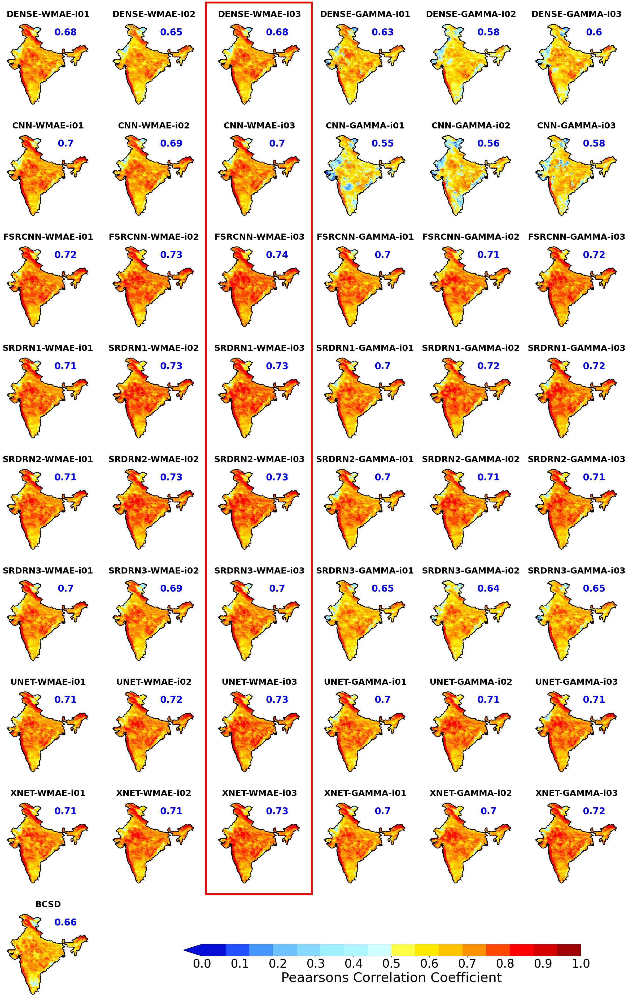

In [321]:
## Masked spatial plots
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import geopandas as gpd
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.patches import PathPatch
import cmaps
from shapely.geometry import box
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches

#################### Calculate metric value ####################

def abs_mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(abs(arr))
    return arr

def mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(arr)
    return arr

def create_axes(nrows, ncols, figsize=(13,13), hspace=None, wspace=None):
    
    # Create figure and axis objects
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace) #  , wspace=wspace hspace=0.5, wspace=0

    # Create subplots with specific projection using GridSpec
    axes = []
    for i in range(nrows):
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            axes.append(ax)
    # fig.tight_layout()

    # fig.tight_layout(pad=0) 
    # plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    return fig, axes

def get_lon_lat(ds, data_var):
    """
    Extract longitude and latitude values from 
    xarray array and variable name
    """
    
    data_coords = ds[data_var].coords
    lon_var, lat_var = None, None

    for coord_name, coord_var in data_coords.items():
        if 'longitude' in coord_var.standard_name or 'lon' in coord_var.standard_name:
            lon_var = coord_var
        elif 'latitude' in coord_var.standard_name or 'lat' in coord_var.standard_name:
            lat_var = coord_var

    return lon_var, lat_var

def filter_df(df, column, string):
    """ Select and merge rows from the dataframe where the specified string is present in the specified column""" 
    filtered_df = df[df[column].str.contains(string, na=False)]
    return filtered_df

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict('list')

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def my_custom_subplot(ax, ds, lonlat, cmap, vmin, vmax, 
                      title=None, ylabel=None, 
                      text=None, text_loc=None, 
                      overlay_pval=False, pval_data=None, 
                     ):
    
    # Plot data ds1 with inverted y-axis
    im = ax.imshow(ds, 
                   cmap=cmap, 
                   alpha=1.0, 
                   vmin=vmin, 
                   vmax=vmax,
                   extent=[lonlat[0].data.min(), 
                           lonlat[0].data.max(),
                           lonlat[1].data.max(),
                           lonlat[1].data.min()], 
                   origin='upper', 
                   transform=ccrs.PlateCarree()
                  )
    # ---------------
    # Add coastlines
    # ---------------
    # ax.coastlines(resolution='50m')
    ax.invert_yaxis()
    
    # --------------------
    # Add India shapefile
    # --------------------
    shapefile_path = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES/India.shp"         
    shapefile_df = gpd.read_file(shapefile_path)
    countries = shapefile_df['geometry']
    ax.add_geometries(countries, ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=2)

    # -----------------------
    # Overlay pvalue hatches 
    # -----------------------
    if overlay_pval:

        if pval_data is None:
            raise ValueError('You have asked to plot pval stipples, but no data passed.')
        else:
            significance_threshold = 0.01
            significant_mask = pval_data <= significance_threshold
        

    
        # Overlay hatched polygons for significant correlations
        bbox = box(lonlat[0].data.min(), lonlat[1].data.min(), lonlat[0].data.max(), lonlat[1].data.max())
        for geom in countries:
            if bbox.intersects(geom):
                masked_geom = geom.intersection(bbox)
                if masked_geom.is_empty:
                    continue   
                if significant_mask.sel(longitude=slice(masked_geom.bounds[0], masked_geom.bounds[2]),
                                         latitude=slice(masked_geom.bounds[1], masked_geom.bounds[3])).any():
                    ax.add_geometries([masked_geom], 
                                      ccrs.PlateCarree(), 
                                      facecolor='none', 
                                      edgecolor='k', 
                                      hatch='.', 
                                      linewidth=1)
                    continue
    
    # -------------------------
    # Add text inside the plot
    # -------------------------
    if text is not None:
        ax.text(text_loc[0], text_loc[1], 
                text, 
                transform=ax.transAxes, ha='center', va='center', 
                fontsize=25, fontweight='bold', 
                color='blue', backgroundcolor=None, bbox=None)

    # ------------------------------
    # Additional plot customization
    # ------------------------------
    ax.set_title(title, loc='center', fontsize=23, fontweight='semibold')
    ax.set_ylabel(ylabel, loc='center', fontsize=22, fontweight='semibold')
    ax.set_xticks(np.arange(70, 100, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(10, 40, 5), crs=ccrs.PlateCarree())
    lon_formatter = LongitudeFormatter(zero_direction_label=False)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.tick_params(axis="both", labelsize=12)

    ax.set_axis_off()
    
    return im


#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

# Create axes for subplots and set lonlat limits
fig, axes = create_axes(nrows=9, ncols=6, figsize=(30,45), hspace=0.1, wspace=None)
lon_l, lat_l = (70, 98, 5), (10, 38, 5)

# Load datafiles
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
d = xr.open_dataset(f'{DPATH}/EVAL_METRICS_SPATIAL_v1.nc')
df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")

m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES/India.nc')

varname = 'PCC'
cbar_label = 'Peaarsons Correlation Coefficient'

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
df = filter_df(df, column='ZONE_NAME', string="INDIA")
# df = filter_df(df, column='EXP_ID', string="L01")

exp_dict = df_to_dict(df, key_col="EXP_ID", value_cols=["LABEL", varname])

#-----------------------------------------------------------------------
############################# Edit below ###############################
#-----------------------------------------------------------------------

cmap = cmaps.GMT_panoply
vmin, vmax, inc = 0, 1, 0.1

for i, (exp_id, (title, metric_val)) in enumerate(exp_dict.items()):
    
    my_var = f'{exp_id}_{varname}'
    ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
    im = my_custom_subplot(ax=axes[i], 
                    ds=ds_f,
                    lonlat=get_lon_lat(d, my_var), 
                    cmap=cmap, vmin=vmin, vmax=vmax,
                    text=abs_mean(ds_f.data).round(2), #round(metric_val, 3), #mean(d[my_var][:].data).round(4),
                    text_loc=[0.7, 0.85],
                    ylabel=None,
                    title=title,
                    overlay_pval=False,
                    pval_data = d[f'{exp_id}_TSTAT_PVAL'],
                    )
    
#----------------------------------------------------
# Add the rectangular box to the Figure object
#----------------------------------------------------

# Calculate the rectangle position and size to cover the third column
x = axes[2].get_position().xmin - 0.012 # x position of the third column
y = axes[44].get_position().ymin  - 0.057  # Shift down by decreasing y position
width = axes[2].get_position().width * 1.2  # width of the third column subplot
height = (axes[2].get_position().ymax  * 1.1) - (axes[44].get_position().ymin * 1.1)  # total height of the third column

# Add the rectangle to the figure using fig.patches
rect = patches.Rectangle((x, y), width, height, linewidth=5, edgecolor='r', facecolor='none', transform=fig.transFigure)
fig.patches.append(rect)  # Add patch to fig.patches

#----------------------------------------------------
# Uncomment below code snippet to set horizontal cbar 
#----------------------------------------------------

fig.subplots_adjust(bottom=0.05)
cbar_ax = fig.add_axes([0.35, 0.09, 0.5, 0.01])
cb = fig.colorbar(im, cax=cbar_ax, 
                  ticks=np.arange(vmin, vmax+inc, inc), 
                  orientation="horizontal", 
                  extend='min')
cb.ax.tick_params(labelsize=32)
cb.set_label(cbar_label, 
             rotation = 0, 
             fontsize = 36, 
             fontweight='normal') 

for ax in axes[-5:]:
    ax.axis('off')

SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'
# plt.savefig(f'{SAVE_DIR}/Figure_SpatialMap_{varname.upper()}.png', format='png', dpi=400, bbox_inches='tight',facecolor='w', edgecolor='w')
plt.show()



## Figure: Spatial Map of Evaluation Metrics - ACC

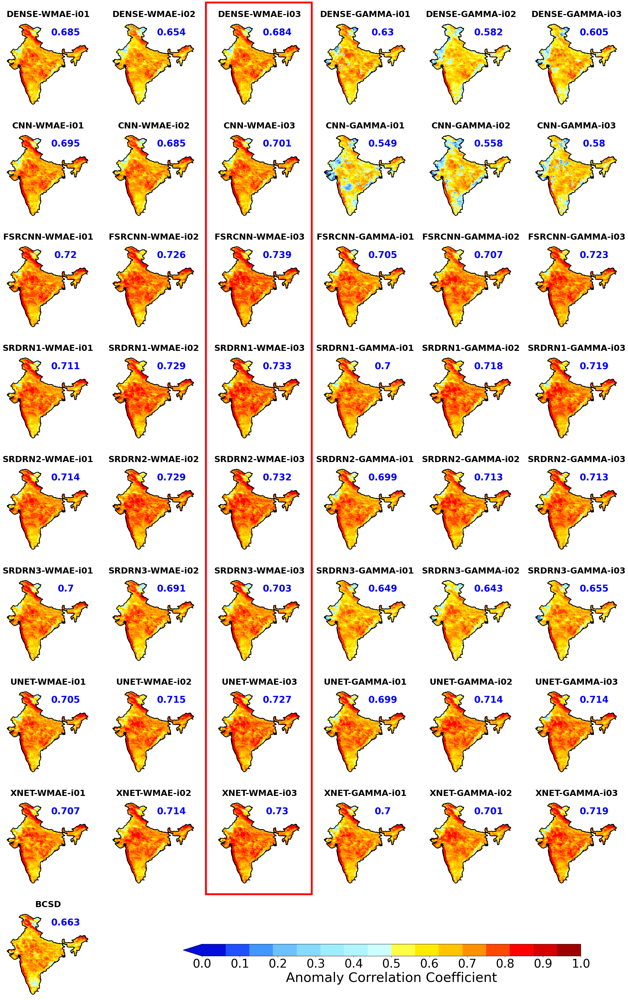

In [328]:
## Masked spatial plots
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import geopandas as gpd
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.patches import PathPatch
import cmaps
from shapely.geometry import box
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches

#################### Calculate metric value ####################

def abs_mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(abs(arr))
    return arr

def mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(arr)
    return arr

def create_axes(nrows, ncols, figsize=(13,13), hspace=None, wspace=None):
    
    # Create figure and axis objects
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace) #  , wspace=wspace hspace=0.5, wspace=0

    # Create subplots with specific projection using GridSpec
    axes = []
    for i in range(nrows):
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            axes.append(ax)
    # fig.tight_layout()

    # fig.tight_layout(pad=0) 
    # plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    return fig, axes

def get_lon_lat(ds, data_var):
    """
    Extract longitude and latitude values from 
    xarray array and variable name
    """
    
    data_coords = ds[data_var].coords
    lon_var, lat_var = None, None

    for coord_name, coord_var in data_coords.items():
        if 'longitude' in coord_var.standard_name or 'lon' in coord_var.standard_name:
            lon_var = coord_var
        elif 'latitude' in coord_var.standard_name or 'lat' in coord_var.standard_name:
            lat_var = coord_var

    return lon_var, lat_var

def filter_df(df, column, string):
    """ Select and merge rows from the dataframe where the specified string is present in the specified column""" 
    filtered_df = df[df[column].str.contains(string, na=False)]
    return filtered_df

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict('list')

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def my_custom_subplot(ax, ds, lonlat, cmap, vmin, vmax, 
                      title=None, ylabel=None, 
                      text=None, text_loc=None, 
                      overlay_pval=False, pval_data=None, 
                     ):
    
    # Plot data ds1 with inverted y-axis
    im = ax.imshow(ds, 
                   cmap=cmap, 
                   alpha=1.0, 
                   vmin=vmin, 
                   vmax=vmax,
                   extent=[lonlat[0].data.min(), 
                           lonlat[0].data.max(),
                           lonlat[1].data.max(),
                           lonlat[1].data.min()], 
                   origin='upper', 
                   transform=ccrs.PlateCarree()
                  )
    # ---------------
    # Add coastlines
    # ---------------
    # ax.coastlines(resolution='50m')
    ax.invert_yaxis()
    
    # --------------------
    # Add India shapefile
    # --------------------
    shapefile_path = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES/India.shp"         
    shapefile_df = gpd.read_file(shapefile_path)
    countries = shapefile_df['geometry']
    ax.add_geometries(countries, ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=2)

    # -----------------------
    # Overlay pvalue hatches 
    # -----------------------
    if overlay_pval:

        if pval_data is None:
            raise ValueError('You have asked to plot pval stipples, but no data passed.')
        else:
            significance_threshold = 0.01
            significant_mask = pval_data <= significance_threshold
        

    
        # Overlay hatched polygons for significant correlations
        bbox = box(lonlat[0].data.min(), lonlat[1].data.min(), lonlat[0].data.max(), lonlat[1].data.max())
        for geom in countries:
            if bbox.intersects(geom):
                masked_geom = geom.intersection(bbox)
                if masked_geom.is_empty:
                    continue   
                if significant_mask.sel(longitude=slice(masked_geom.bounds[0], masked_geom.bounds[2]),
                                         latitude=slice(masked_geom.bounds[1], masked_geom.bounds[3])).any():
                    ax.add_geometries([masked_geom], 
                                      ccrs.PlateCarree(), 
                                      facecolor='none', 
                                      edgecolor='k', 
                                      hatch='.', 
                                      linewidth=1)
                    continue
    
    # -------------------------
    # Add text inside the plot
    # -------------------------
    if text is not None:
        ax.text(text_loc[0], text_loc[1], 
                text, 
                transform=ax.transAxes, ha='center', va='center', 
                fontsize=25, fontweight='bold', 
                color='blue', backgroundcolor=None, bbox=None)

    # ------------------------------
    # Additional plot customization
    # ------------------------------
    ax.set_title(title, loc='center', fontsize=23, fontweight='semibold')
    ax.set_ylabel(ylabel, loc='center', fontsize=22, fontweight='semibold')
    ax.set_xticks(np.arange(70, 100, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(10, 40, 5), crs=ccrs.PlateCarree())
    lon_formatter = LongitudeFormatter(zero_direction_label=False)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.tick_params(axis="both", labelsize=12)

    ax.set_axis_off()
    
    return im


#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

# Create axes for subplots and set lonlat limits
fig, axes = create_axes(nrows=9, ncols=6, figsize=(30,45), hspace=0.1, wspace=None)
lon_l, lat_l = (70, 98, 5), (10, 38, 5)

# Load datafiles
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
d = xr.open_dataset(f'{DPATH}/EVAL_METRICS_SPATIAL_v1.nc')
df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")

m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES/India.nc')

varname = 'ACC'
cbar_label = 'Anomaly Correlation Coefficient'

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
df = filter_df(df, column='ZONE_NAME', string="INDIA")
# df = filter_df(df, column='EXP_ID', string="L01")

exp_dict = df_to_dict(df, key_col="EXP_ID", value_cols=["LABEL", varname])

#-----------------------------------------------------------------------
############################# Edit below ###############################
#-----------------------------------------------------------------------

cmap = cmaps.GMT_panoply
vmin, vmax, inc = 0, 1, 0.1

for i, (exp_id, (title, metric_val)) in enumerate(exp_dict.items()):
    
    my_var = f'{exp_id}_{varname}'
    ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
    im = my_custom_subplot(ax=axes[i], 
                    ds=ds_f,
                    lonlat=get_lon_lat(d, my_var), 
                    cmap=cmap, vmin=vmin, vmax=vmax,
                    text=abs_mean(ds_f.data).round(3), #round(metric_val, 3), #mean(d[my_var][:].data).round(4),
                    text_loc=[0.7, 0.85],
                    ylabel=None,
                    title=title,
                    overlay_pval=False,
                    pval_data = d[f'{exp_id}_TSTAT_PVAL'],
                    )
    
#----------------------------------------------------
# Add the rectangular box to the Figure object
#----------------------------------------------------

# Calculate the rectangle position and size to cover the third column
x = axes[2].get_position().xmin - 0.012 # x position of the third column
y = axes[44].get_position().ymin  - 0.057  # Shift down by decreasing y position
width = axes[2].get_position().width * 1.2  # width of the third column subplot
height = (axes[2].get_position().ymax  * 1.1) - (axes[44].get_position().ymin * 1.1)  # total height of the third column

# Add the rectangle to the figure using fig.patches
rect = patches.Rectangle((x, y), width, height, linewidth=5, edgecolor='r', facecolor='none', transform=fig.transFigure)
fig.patches.append(rect)  # Add patch to fig.patches

#----------------------------------------------------
# Uncomment below code snippet to set horizontal cbar 
#----------------------------------------------------

fig.subplots_adjust(bottom=0.05)
cbar_ax = fig.add_axes([0.35, 0.09, 0.5, 0.01])
cb = fig.colorbar(im, cax=cbar_ax, 
                  ticks=np.arange(vmin, vmax+inc, inc), 
                  orientation="horizontal", 
                  extend='min')
cb.ax.tick_params(labelsize=32)
cb.set_label(cbar_label, 
             rotation = 0, 
             fontsize = 36, 
             fontweight='normal') 

for ax in axes[-5:]:
    ax.axis('off')

SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'
# plt.savefig(f'{SAVE_DIR}/Figure_SpatialMap_{varname.upper()}.png', format='png', dpi=400, bbox_inches='tight',facecolor='w', edgecolor='w')
plt.show()



## Figure: Spatial Map of Evaluation Metrics - NSE

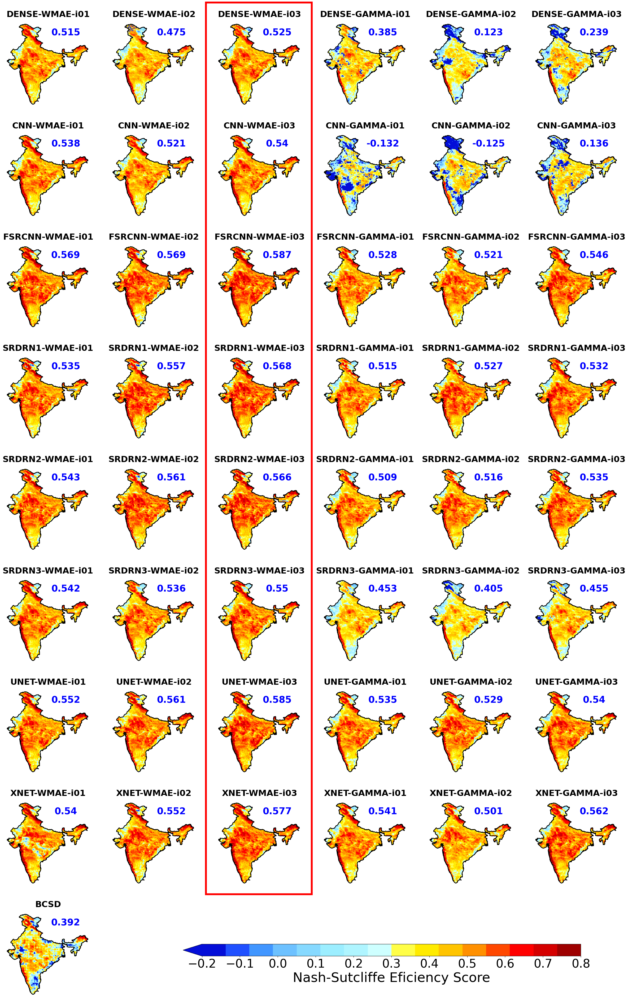

In [327]:
## Masked spatial plots
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import geopandas as gpd
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from matplotlib.patches import PathPatch
import cmaps
from shapely.geometry import box
from matplotlib.gridspec import GridSpec
import matplotlib.patches as patches

#################### Calculate metric value ####################

def abs_mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(abs(arr))
    return arr

def mean(arr):
    """
    Calculates the absolute mean of a given Numpy Array
    """
    arr = arr.flatten()
    arr = np.nanmean(arr)
    return arr

def create_axes(nrows, ncols, figsize=(13,13), hspace=None, wspace=None):
    
    # Create figure and axis objects
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(nrows, ncols, figure=fig, hspace=hspace) #  , wspace=wspace hspace=0.5, wspace=0

    # Create subplots with specific projection using GridSpec
    axes = []
    for i in range(nrows):
        for j in range(ncols):
            ax = fig.add_subplot(gs[i, j], projection=ccrs.PlateCarree())
            axes.append(ax)
    # fig.tight_layout()

    # fig.tight_layout(pad=0) 
    # plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)
    return fig, axes

def get_lon_lat(ds, data_var):
    """
    Extract longitude and latitude values from 
    xarray array and variable name
    """
    
    data_coords = ds[data_var].coords
    lon_var, lat_var = None, None

    for coord_name, coord_var in data_coords.items():
        if 'longitude' in coord_var.standard_name or 'lon' in coord_var.standard_name:
            lon_var = coord_var
        elif 'latitude' in coord_var.standard_name or 'lat' in coord_var.standard_name:
            lat_var = coord_var

    return lon_var, lat_var

def filter_df(df, column, string):
    """ Select and merge rows from the dataframe where the specified string is present in the specified column""" 
    filtered_df = df[df[column].str.contains(string, na=False)]
    return filtered_df

def df_to_dict(df, key_col, value_cols):
    """
    Convert multiple columns of a DataFrame into a dictionary with lists of values.
    """
    return df.set_index(key_col)[value_cols].T.to_dict('list')

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def my_custom_subplot(ax, ds, lonlat, cmap, vmin, vmax, 
                      title=None, ylabel=None, 
                      text=None, text_loc=None, 
                      overlay_pval=False, pval_data=None, 
                     ):
    
    # Plot data ds1 with inverted y-axis
    im = ax.imshow(ds, 
                   cmap=cmap, 
                   alpha=1.0, 
                   vmin=vmin, 
                   vmax=vmax,
                   extent=[lonlat[0].data.min(), 
                           lonlat[0].data.max(),
                           lonlat[1].data.max(),
                           lonlat[1].data.min()], 
                   origin='upper', 
                   transform=ccrs.PlateCarree()
                  )
    # ---------------
    # Add coastlines
    # ---------------
    # ax.coastlines(resolution='50m')
    ax.invert_yaxis()
    
    # --------------------
    # Add India shapefile
    # --------------------
    shapefile_path = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/SHAPEFILES/India.shp"         
    shapefile_df = gpd.read_file(shapefile_path)
    countries = shapefile_df['geometry']
    ax.add_geometries(countries, ccrs.PlateCarree(), facecolor='none', edgecolor='black', linewidth=2)

    # -----------------------
    # Overlay pvalue hatches 
    # -----------------------
    if overlay_pval:

        if pval_data is None:
            raise ValueError('You have asked to plot pval stipples, but no data passed.')
        else:
            significance_threshold = 0.01
            significant_mask = pval_data <= significance_threshold
        

    
        # Overlay hatched polygons for significant correlations
        bbox = box(lonlat[0].data.min(), lonlat[1].data.min(), lonlat[0].data.max(), lonlat[1].data.max())
        for geom in countries:
            if bbox.intersects(geom):
                masked_geom = geom.intersection(bbox)
                if masked_geom.is_empty:
                    continue   
                if significant_mask.sel(longitude=slice(masked_geom.bounds[0], masked_geom.bounds[2]),
                                         latitude=slice(masked_geom.bounds[1], masked_geom.bounds[3])).any():
                    ax.add_geometries([masked_geom], 
                                      ccrs.PlateCarree(), 
                                      facecolor='none', 
                                      edgecolor='k', 
                                      hatch='.', 
                                      linewidth=1)
                    continue
    
    # -------------------------
    # Add text inside the plot
    # -------------------------
    if text is not None:
        ax.text(text_loc[0], text_loc[1], 
                text, 
                transform=ax.transAxes, ha='center', va='center', 
                fontsize=25, fontweight='bold', 
                color='blue', backgroundcolor=None, bbox=None)

    # ------------------------------
    # Additional plot customization
    # ------------------------------
    ax.set_title(title, loc='center', fontsize=23, fontweight='semibold')
    ax.set_ylabel(ylabel, loc='center', fontsize=22, fontweight='semibold')
    ax.set_xticks(np.arange(70, 100, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(10, 40, 5), crs=ccrs.PlateCarree())
    lon_formatter = LongitudeFormatter(zero_direction_label=False)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.tick_params(axis="both", labelsize=12)

    ax.set_axis_off()
    
    return im


#-----------------------------------------------------------------------
######################## Main run control below ########################
#-----------------------------------------------------------------------

# Create axes for subplots and set lonlat limits
fig, axes = create_axes(nrows=9, ncols=6, figsize=(30,45), hspace=0.1, wspace=None)
lon_l, lat_l = (70, 98, 5), (10, 38, 5)

# Load datafiles
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
d = xr.open_dataset(f'{DPATH}/EVAL_METRICS_SPATIAL_v1.nc')
df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")

m = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES/India.nc')

varname = 'NSE'
cbar_label = 'Nash-Sutcliffe Eficiency Score'

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
df = filter_df(df, column='ZONE_NAME', string="INDIA")
# df = filter_df(df, column='EXP_ID', string="L01")

exp_dict = df_to_dict(df, key_col="EXP_ID", value_cols=["LABEL", varname])

#-----------------------------------------------------------------------
############################# Edit below ###############################
#-----------------------------------------------------------------------

cmap = cmaps.GMT_panoply
vmin, vmax, inc = -0.2, 0.8, 0.1

for i, (exp_id, (title, metric_val)) in enumerate(exp_dict.items()):
    
    my_var = f'{exp_id}_{varname}'
    ds_f = mask_array(d[my_var].squeeze(), m['mask'].squeeze())
    im = my_custom_subplot(ax=axes[i], 
                    ds=ds_f,
                    lonlat=get_lon_lat(d, my_var), 
                    cmap=cmap, vmin=vmin, vmax=vmax,
                    text=round(metric_val, 3), #, # #mean(d[my_var][:].data).round(4),
                    text_loc=[0.7, 0.85],
                    ylabel=None,
                    title=title,
                    overlay_pval=False,
                    pval_data = d[f'{exp_id}_TSTAT_PVAL'],
                    )
    
#----------------------------------------------------
# Add the rectangular box to the Figure object
#----------------------------------------------------

# Calculate the rectangle position and size to cover the third column
x = axes[2].get_position().xmin - 0.012 # x position of the third column
y = axes[44].get_position().ymin  - 0.057  # Shift down by decreasing y position
width = axes[2].get_position().width * 1.2  # width of the third column subplot
height = (axes[2].get_position().ymax  * 1.1) - (axes[44].get_position().ymin * 1.1)  # total height of the third column

# Add the rectangle to the figure using fig.patches
rect = patches.Rectangle((x, y), width, height, linewidth=5, edgecolor='r', facecolor='none', transform=fig.transFigure)
fig.patches.append(rect)  # Add patch to fig.patches

#----------------------------------------------------
# Uncomment below code snippet to set horizontal cbar 
#----------------------------------------------------

fig.subplots_adjust(bottom=0.05)
cbar_ax = fig.add_axes([0.35, 0.09, 0.5, 0.01])
cb = fig.colorbar(im, cax=cbar_ax, 
                  ticks=np.arange(vmin, vmax+inc, inc), 
                  orientation="horizontal", 
                  extend='min')
cb.ax.tick_params(labelsize=32)
cb.set_label(cbar_label, 
             rotation = 0, 
             fontsize = 36, 
             fontweight='normal') 

for ax in axes[-5:]:
    ax.axis('off')

SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'
# plt.savefig(f'{SAVE_DIR}/Figure_SpatialMap_{varname.upper()}.png', format='png', dpi=400, bbox_inches='tight',facecolor='w', edgecolor='w')
plt.show()



## Figure: Bar Plot of Evaluation Metrics

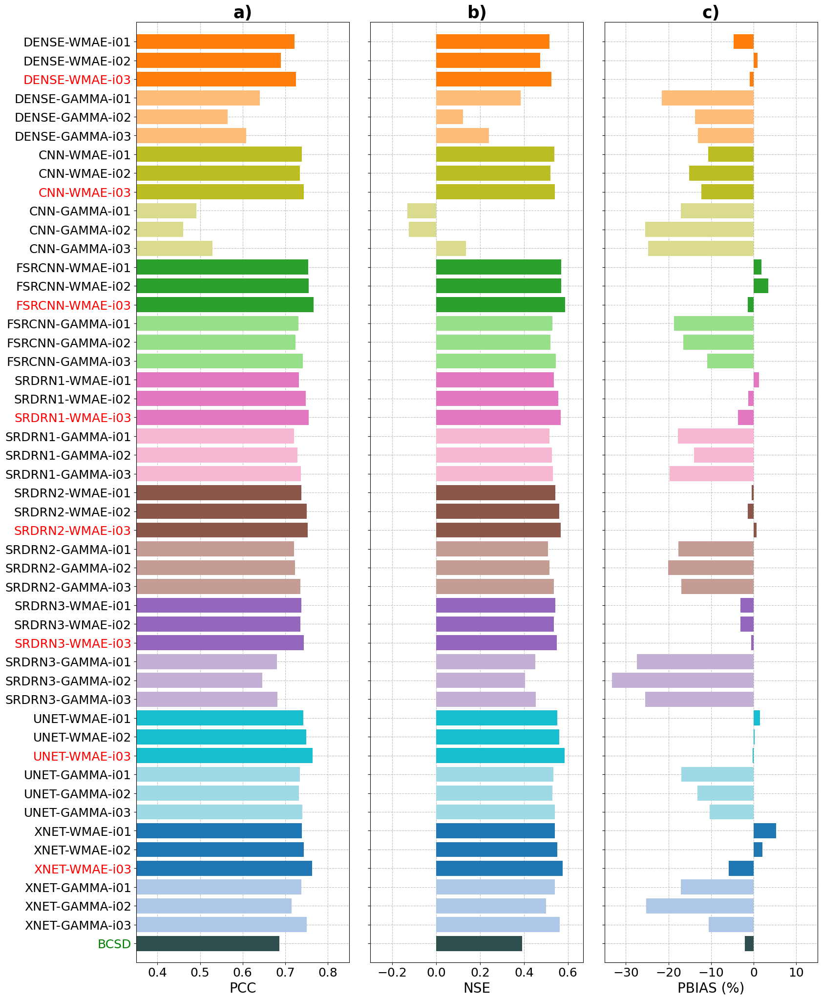

In [403]:
import pandas as pd
import matplotlib.pyplot as plt

def filter_df(df, column, string):
    """Select and merge rows from the dataframe where the specified string is present in the specified column."""
    return df[df[column].str.contains(string, na=False)]

def plot_hbars(ax, df, metric_name = "PCC", xlabel=None, xlim=(None, None), title= 'Metric bars', yticks_off= False):
    
    # Reverse the order of rows
    df = df.iloc[::-1]
    
    # # Create a color list with the desired pattern
    # bar_colors = ["#2F4F4F"]  # Start with dark grey for the 0th bar
    
    # # Alternate between blue colors for the remaining bars
    # for i in range(1, len(df)):
    #     if (i - 1) // 3 % 2 == 0:
    #         bar_colors.append("#87CEEB")  # Dark blue
    #     else:
    #         bar_colors.append("#4682B4")  # Light blue

    bar_colors = [
    "#2F4F4F",
    "#aec7e8", "#aec7e8", "#aec7e8", "#1f77b4", "#1f77b4", "#1f77b4",  # Blue pair
    "#9edae5", "#9edae5", "#9edae5", "#17becf", "#17becf", "#17becf",  # Teal pair 
    "#c5b0d5", "#c5b0d5", "#c5b0d5", "#9467bd", "#9467bd", "#9467bd",  # Purple pair
    "#c49c94", "#c49c94", "#c49c94", "#8c564b", "#8c564b", "#8c564b",  # Brown pair
    "#f7b6d2", "#f7b6d2", "#f7b6d2", "#e377c2", "#e377c2", "#e377c2",  # Pink pair
     "#98df8a", "#98df8a", "#98df8a", "#2ca02c", "#2ca02c", "#2ca02c",  # Green pair
    "#dbdb8d", "#dbdb8d", "#dbdb8d", "#bcbd22", "#bcbd22", "#bcbd22",  # Yellow-green pair
    "#ffbb78", "#ffbb78", "#ffbb78", "#ff7f0e", "#ff7f0e", "#ff7f0e",  # Orange pair
    ]

    # ax.set_facecolor("#E0E0E0")
    ax.grid(True, axis='both', linestyle='--', alpha=0.8, zorder=1)
    
    # # Plot horizontal bar chart with the defined colors
    # ax.barh(df['LABEL'], df[metric_name], height=0.85, color=bar_colors, zorder=2)
    ax.barh(df['LABEL'], df[metric_name], color=bar_colors, zorder=2)
    
    # Get the max 'PCC' value for rows labeled with 'BCSD'
    bcsd_max_pcc = df.loc[df['LABEL'].str.contains('BCSD', na=False), 'PCC'].max()
    
    # Labels and title
    ax.tick_params(axis='both', labelsize=18)  # Set x tick size
    ax.set_xlabel(metric_name if xlabel is None else xlabel, fontsize=20, fontweight='normal')
    ax.set_title(title, fontsize=25, fontweight='bold')
    ax.set_xlim(xlim[0], xlim[1])

    if yticks_off:
        ax.tick_params(axis='y', which='both', labelleft=False)
    
    # Change the color of ytick if label is "WMAE-i03"
    for label in ax.get_yticklabels():
        if "WMAE-i03" in label.get_text():
            label.set_color("red")
        if "BCSD" in label.get_text():
            label.set_color("green")

    ax.set_ylim(-1, len(df) + 0.05)
    

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"


# Create a 2x2 grid of subplots with specified figure size and spacing
fig, axs = plt.subplots(1, 3, figsize=(18, 25), gridspec_kw={'wspace': 0.1, 'hspace': 0.15}) 

# Load the DataFrame and filter
df1 = pd.read_csv(f'{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv')
df1 = filter_df(df1, column='ZONE_NAME', string="INDIA")

# Load the DataFrame and filter
df2 = pd.read_csv(f'{DPATH}/TABLE_EVALMETRICS_JJAS_v1.0.0.csv')
df2 = filter_df(df2, column='ZONE_NAME', string="MONSOON CORE ZONE")

# Plotting the bar charts in the correct subplot axes
plot_hbars(axs[0], df1, metric_name = "PCC", title='a)', xlim=(0.35,0.85))
plot_hbars(axs[1], df1, metric_name = "NSE", title='b)',  xlim=(-0.3,0.67), yticks_off=True)
plot_hbars(axs[2], df2, metric_name = "PBIAS", xlabel="PBIAS (%)", title='c)',  xlim=(-35, 15), yticks_off=True)

SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'
# plt.savefig(f'{SAVE_DIR}/Figure_Eval_Metrics_Table_BarPlots.png', format='png', dpi=400, bbox_inches='tight',facecolor='w', edgecolor='w')
plt.show()


### Plot as Stem Plots

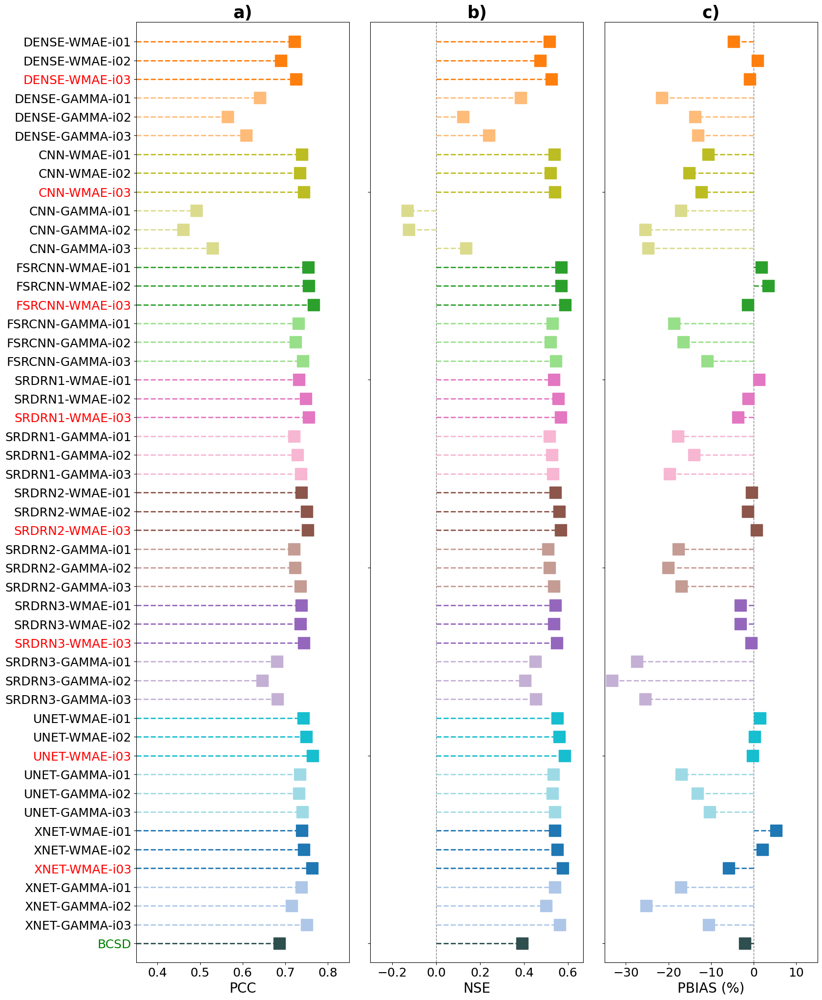

In [402]:
import pandas as pd
import matplotlib.pyplot as plt

def filter_df(df, column, string):
    """Select and merge rows from the dataframe where the specified string is present in the specified column."""
    return df[df[column].str.contains(string, na=False)]

def plot_hstems(ax, df, metric_name="PCC", xlabel=None, xlim=(None, None), title='Metric Markers', yticks_off=False, ref_val=0):
    
    # Reverse the order of rows
    df = df.iloc[::-1]
    
    # Marker colors
    marker_colors = [
        "#2F4F4F",
        "#aec7e8", "#aec7e8", "#aec7e8", "#1f77b4", "#1f77b4", "#1f77b4",  # Blue pair
        "#9edae5", "#9edae5", "#9edae5", "#17becf", "#17becf", "#17becf",  # Teal pair 
        "#c5b0d5", "#c5b0d5", "#c5b0d5", "#9467bd", "#9467bd", "#9467bd",  # Purple pair
        "#c49c94", "#c49c94", "#c49c94", "#8c564b", "#8c564b", "#8c564b",  # Brown pair
        "#f7b6d2", "#f7b6d2", "#f7b6d2", "#e377c2", "#e377c2", "#e377c2",  # Pink pair
        "#98df8a", "#98df8a", "#98df8a", "#2ca02c", "#2ca02c", "#2ca02c",  # Green pair
        "#dbdb8d", "#dbdb8d", "#dbdb8d", "#bcbd22", "#bcbd22", "#bcbd22",  # Yellow-green pair
        "#ffbb78", "#ffbb78", "#ffbb78", "#ff7f0e", "#ff7f0e", "#ff7f0e",  # Orange pair
    ]
    
    ax.grid(False)

    if ref_val is not None:
        ax.axvline(x=ref_val, color='grey', linestyle='--', linewidth=1)

    # Plot stems and markers individually
    for i, (label, value, color) in enumerate(zip(df['LABEL'], df[metric_name], marker_colors)):
        ax.plot([0, value], [i, i], color=color, linewidth=2, linestyle='--', zorder=2)
        ax.plot(value, i, marker='s', markersize=17, color=color, markeredgecolor=color, zorder=2)

    if yticks_off:
        ax.tick_params(axis='y', which='both', labelleft=False)
    else:
        # Set custom y-ticks and labels
        ax.set_yticks(range(len(df)))
        ax.set_yticklabels(df['LABEL'])
        
    # Labels and title
    ax.tick_params(axis='both', labelsize=18)  # Set x tick size
    ax.set_xlabel(metric_name if xlabel is None else xlabel, fontsize=20, fontweight='normal')
    ax.set_title(title, fontsize=25, fontweight='bold')
    ax.set_xlim(xlim[0], xlim[1])
   
    # Change the color of ytick if label is "WMAE-i03"
    for label in ax.get_yticklabels():
        if "WMAE-i03" in label.get_text():
            label.set_color("red")
        if "BCSD" in label.get_text():
            label.set_color("green")

    ax.set_ylim(-1, len(df) + 0.05)

# File paths and loading data
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

fig, axs = plt.subplots(1, 3, figsize=(18, 25), gridspec_kw={'wspace': 0.1, 'hspace': 0.15}) 

# Load and filter data
df1 = pd.read_csv(f'{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv')
df1 = filter_df(df1, column='ZONE_NAME', string="INDIA")

df2 = pd.read_csv(f'{DPATH}/TABLE_EVALMETRICS_JJAS_v1.0.0.csv')
df2 = filter_df(df2, column='ZONE_NAME', string="MONSOON CORE ZONE")

# Plotting with markers
plot_hstems(axs[0], df1, metric_name="PCC", title='a)', xlim=(0.35, 0.85))
plot_hstems(axs[1], df1, metric_name="NSE", title='b)', xlim=(-0.3, 0.67), yticks_off=True)
plot_hstems(axs[2], df2, metric_name="PBIAS", xlabel="PBIAS (%)", title='c)', xlim=(-35, 15), yticks_off=True)

SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'
# plt.savefig(f'{SAVE_DIR}/Figure_Eval_Metrics_Table_StemPlots.png', format='png', dpi=400, bbox_inches='tight', facecolor='w', edgecolor='w')
plt.show()


## Figure: Boxplot Eval Metrics

### Prepare dataset as csv

In [173]:
import numpy as np
import pandas as pd
import xarray as xr

def custom_masker(mask_path, data_ds, model_id, metric_name='KGE'):
    """Mask an xarray DataArray to apply the region mask and flatten the data."""
    dataarray = data_ds[f'{model_id}_{metric_name}'].squeeze()
    maskarray = xr.open_dataset(mask_path).mask.squeeze()
    
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape != maskarray.shape:
        raise ValueError("dataarray and maskarray must have the same shape")
        
    masked_array = (dataarray * maskarray).data.flatten()
    masked_array = masked_array[~np.isnan(masked_array)]
    return masked_array

def df_to_dict(df, key_col, value_col):
    """Convert a DataFrame to a dictionary with unique keys and corresponding values."""
    return df.set_index(key_col)[value_col].to_dict()

def filter_df(df, column, string):
    """Select and merge rows from the dataframe where the specified string is present in the specified column."""
    return df[df[column].str.contains(string, na=False)]

MASK_PATH = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES'
zones_dict = {'IND': [f'{MASK_PATH}/India.nc', 'INDIA']} 

DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"
SPATH = DPATH

df = pd.read_csv(f"{DPATH}/TABLE_EVALMETRICS_ALLD_v1.0.0.csv")
df = filter_df(df, column='ZONE_NAME', string="INDIA")
data_dict = df_to_dict(df, key_col="EXP_ID", value_col="LABEL")

data_ds = xr.open_dataset(f'{DPATH}/EVAL_METRICS_SPATIAL_v1.nc')

########## Save the PCC, NSE, RMSE and PBIAS data as separate csv ###########
for metric_name in ["PCC", "NSE", "RMSE", "PBIAS"]:

    data_load = {zone: pd.DataFrame({model_label: custom_masker(zone_mask_path, data_ds, model_id, metric_name) 
                                     for model_id, model_label in data_dict.items()}) 
                 for zone, (zone_mask_path, zone_label) in zones_dict.items()}
    
    df = pd.DataFrame(data_load['IND'])

    csv_name = f"EVAL_METRICS_SPATIAL_FLATTEN_{metric_name}.csv"
    df.to_csv(f"{SPATH}/{csv_name}", index=False)
    print(f"Saved {SPATH}/{csv_name}")


Saved /home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/EVAL_METRICS_SPATIAL_FLATTEN_PCC.csv
Saved /home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/EVAL_METRICS_SPATIAL_FLATTEN_NSE.csv
Saved /home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/EVAL_METRICS_SPATIAL_FLATTEN_RMSE.csv
Saved /home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/EVAL_METRICS_SPATIAL_FLATTEN_PBIAS.csv


### Plot the Diagram

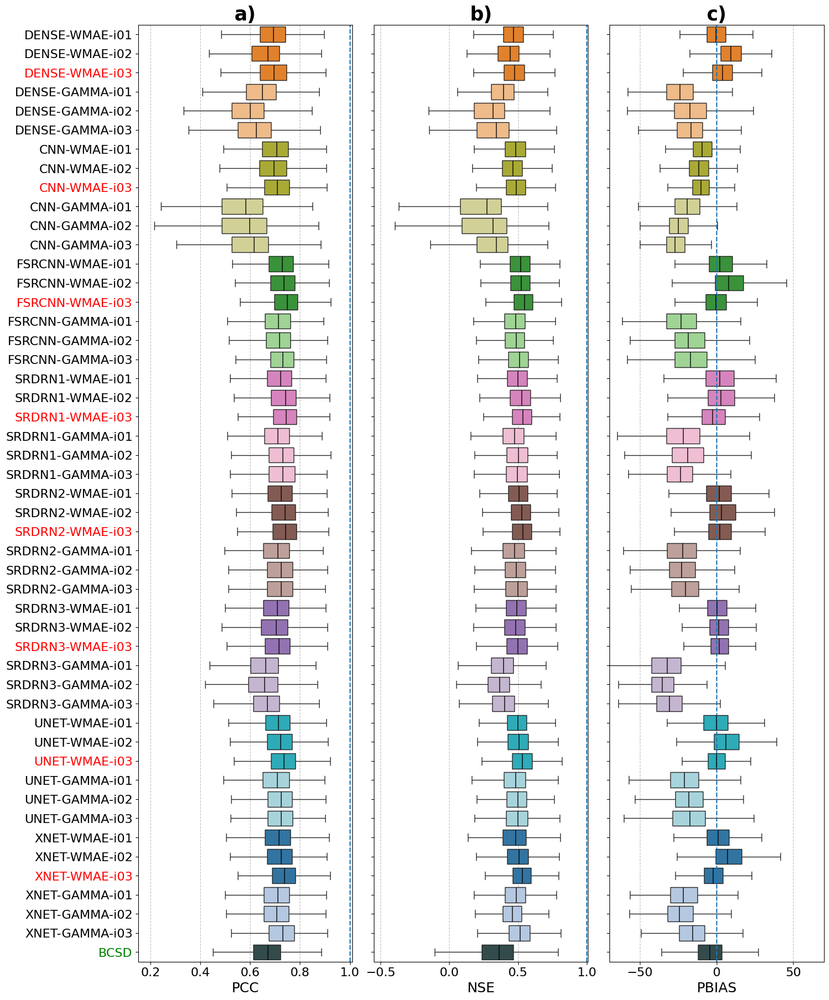

In [406]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def plot_hboxes(ax, df, xlabel="PCC", xlim=(None, None), title='Box Plots', ref_val=None, yticks_off=False):

    # # Set the style of the plots
    # sns.set_style("white")
    
    # # Create a color list with the desired pattern
    # colours = ["grey"]  # Start with dark grey for the 0th bar
    
    # # Alternate between blue colors for the remaining bars
    # for i in range(1, len(df.columns)):
    #     if (i - 1) // 3 % 2 == 0:
    #         colours.append("#87CEEB")  # Light blue
    #     else:
    #         colours.append("#4682B4")  # Dark blue

        
    colours = [
    "#2F4F4F",
    "#aec7e8", "#aec7e8", "#aec7e8", "#1f77b4", "#1f77b4", "#1f77b4",  # Blue pair
    "#9edae5", "#9edae5", "#9edae5", "#17becf", "#17becf", "#17becf",  # Teal pair 
    "#c5b0d5", "#c5b0d5", "#c5b0d5", "#9467bd", "#9467bd", "#9467bd",  # Purple pair
    "#c49c94", "#c49c94", "#c49c94", "#8c564b", "#8c564b", "#8c564b",  # Brown pair
    "#f7b6d2", "#f7b6d2", "#f7b6d2", "#e377c2", "#e377c2", "#e377c2",  # Pink pair
     "#98df8a", "#98df8a", "#98df8a", "#2ca02c", "#2ca02c", "#2ca02c",  # Green pair
    "#dbdb8d", "#dbdb8d", "#dbdb8d", "#bcbd22", "#bcbd22", "#bcbd22",  # Yellow-green pair
    "#ffbb78", "#ffbb78", "#ffbb78", "#ff7f0e", "#ff7f0e", "#ff7f0e",  # Orange pair
    ]
    # Reverse the order of colors
    colours.reverse()  # This will reverse the list
    
    # Create the boxplot in the first subplot with specified colors
    # sns.boxplot(data=df, ax=ax, orient='h', showfliers=False, palette=colours)  # Use the palette directly
    ax.grid(True, axis='both', linestyle='--', alpha=0.8, zorder=1)
    
    sns.boxplot(data=df, ax=ax, orient='h', showfliers=False, palette=colours, 
                medianprops=dict(color='black'),
                meanprops=dict(marker='o', markerfacecolor='orange'), zorder=2,
                )
    
    ax.set_title(title, fontsize=25, fontweight='bold')
    ax.set_xlabel(xlabel, fontsize=18)
    ax.tick_params(axis='both', labelsize=16) 

    ax.set_xlim(xlim[0], xlim[1])

    if ref_val is not None:
        ax.axvline(x=ref_val, linestyle='--') 
    
    # Change the color of ytick if label is "WMAE-i03"
    for label in ax.get_yticklabels():
        if "WMAE-i03" in label.get_text():
            label.set_color("red")
        if "BCSD" in label.get_text():
            label.set_color("green")
    
    if yticks_off:
        ax.tick_params(axis='y', which='both', labelleft=False)

    # ax.grid(True, axis='y', linestyle='--', alpha=0.8)
    
###########################################################################################

# Assuming df contains the DataFrame with your data
csv_save_dir = '/home/midhunm/AI4KLIM/EXPMNTS/P03B_SRDRN_Downscaling_AuxVars/ANALYSE/RESULTS'
csv_name = 'P03B_TABLE_INDMASK_TEST_R99Mon_SelExp_EXPLAINED_VARIANCE_v1.0.0.csv'

CSV_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

df_pcc = pd.read_csv(f"{CSV_PATH}/EVAL_METRICS_SPATIAL_FLATTEN_PCC.csv")
df_nse = pd.read_csv(f"{CSV_PATH}/EVAL_METRICS_SPATIAL_FLATTEN_NSE.csv")
df_pbias = pd.read_csv(f"{CSV_PATH}/EVAL_METRICS_SPATIAL_FLATTEN_PBIAS.csv")

# Create a 1x4 grid of subplots with specified figure size and spacing
fig, axs = plt.subplots(1, 3, figsize=(16, 22), gridspec_kw={'wspace': 0.1, 'hspace': 0.15}) 

# Plotting the box plots in the correct subplot axes
plot_hboxes(axs[0], df_pcc, xlabel="PCC", title='a)', ref_val=1, xlim=(0.15, 1.01),)
plot_hboxes(axs[1], df_nse, xlabel="NSE", title='b)', yticks_off=True, ref_val=1, xlim=(-0.55, 1.01),)
plot_hboxes(axs[2], df_pbias, xlabel="PBIAS", title='c)', xlim=(-70, 70), yticks_off=True, ref_val=0)


SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'
plt.savefig(f'{SAVE_DIR}/Figure_Eval_Metrics_Spatial_BoxPlots.png', format='png', dpi=400, bbox_inches='tight', facecolor='w', edgecolor='w')
plt.show()


## Figure: Spider Plot of Climate Indices

### Prepare data in CDO

In [ ]:
"""
#!/bin/bash

SOURCEPATH="/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/GENDATA"
DESTINPATH="/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/CLIMATE_INDICES"

explist=(
ref
c01
n01_l01_i01
n01_l01_i02
n01_l01_i03
n01_l02_i01
n01_l02_i02
n01_l02_i03
n02_l01_i01
n02_l01_i02
n02_l01_i03
n02_l02_i01
n02_l02_i02
n02_l02_i03
n03_l01_i01
n03_l01_i02
n03_l01_i03
n03_l02_i01
n03_l02_i02
n03_l02_i03
s01_l01_i01
s01_l01_i02
s01_l01_i03
s01_l02_i01
s01_l02_i02
s01_l02_i03
s02_l01_i01
s02_l01_i02
s02_l01_i03
s02_l02_i01
s02_l02_i02
s02_l02_i03
s03_l01_i01
s03_l01_i02
s03_l01_i03
s03_l02_i01
s03_l02_i02
s03_l02_i03
u01_l01_i01
u01_l01_i02
u01_l01_i03
u01_l02_i01
u01_l02_i02
u01_l02_i03
u02_l01_i01
u02_l01_i02
u02_l01_i03
u02_l02_i01
u02_l02_i02
u02_l02_i03
)

################################################ P07A_CLIMATE_INDICES_RX1DAYMON_v1.nc ################################################

echo Processing .. "RX1DAYMON"
#----------------------------------------------------------------------------------------------------
varname=RX1DAYMON
OUTFILE=P07A_CLIMATE_INDICES_${varname}_v1.nc
#----------------------------------------------------------------------------------------------------

DIR=TEMP

if [ "$1" = "c" ]; then
    rm -rfv $DIR
fi

if [ "$2" = "d" ]; then
    rm -v ${DESTINPATH}/${OUTFILE}
fi

mkdir -p "${DIR}"


for exp_id in ${explist[@]}; do
        filepath=$(find ${SOURCEPATH} -maxdepth 1 -name "*${exp_id}*.nc" -type f | sed 's/\.\///')
        filename=$(basename "$filepath")
        echo "${filename}"
        cdo -v -L \
        -setname,${exp_id^^}_${varname} \
        -etccdi_rx1day,freq=month "${SOURCEPATH}/${filename}" \
        "${PWD}/${DIR}/TEMP_${exp_id}_${varname}.nc"
        echo ''
done

cdo -v -L merge ${DIR}/TEMP*.nc ${DESTINPATH}/${OUTFILE}

################################################ P07A_CLIMATE_INDICES_RMONMEAN_v1.nc ################################################

echo Processing .. "RMONMEAN"
#----------------------------------------------------------------------------------------------------
varname=RMONMEAN
OUTFILE=P07A_CLIMATE_INDICES_${varname}_v1.nc
#----------------------------------------------------------------------------------------------------

DIR=TEMP

if [ "$1" = "c" ]; then
    rm -rfv $DIR
fi

if [ "$2" = "d" ]; then
    rm -v ${DESTINPATH}/${OUTFILE}
fi

mkdir -p "${DIR}"


for exp_id in ${explist[@]}; do
        filepath=$(find ${SOURCEPATH} -maxdepth 1 -name "*${exp_id}*.nc" -type f | sed 's/\.\///')
        filename=$(basename "$filepath")
        echo "${filename}"
        cdo -v -L \
        -setname,${exp_id^^}_${varname} \
        -monmean "${SOURCEPATH}/${filename}" \
        "${PWD}/${DIR}/TEMP_${exp_id}_${varname}.nc"
        echo ''
done

cdo -v -L merge ${DIR}/TEMP*.nc ${DESTINPATH}/${OUTFILE}

######################################### P07A_CLIMATE_INDICES_R{99/95/90/75/50}MON_v1.nc ########################################

for pctl in 99 95 90 75 50 25 1 2 98; do
echo Processing .. R${pctl}MON
#----------------------------------------------------------------------------------------------------
varname=R${pctl}MON
OUTFILE=P07A_CLIMATE_INDICES_${varname}_v1.nc
#----------------------------------------------------------------------------------------------------

DIR=TEMP

if [ "$1" = "c" ]; then
    rm -rfv $DIR
fi

if [ "$2" = "d" ]; then
    rm -v ${DESTINPATH}/${OUTFILE}
fi

mkdir -p "${DIR}"


for exp_id in ${explist[@]}; do
        filepath=$(find ${SOURCEPATH} -maxdepth 1 -name "*${exp_id}*.nc" -type f | sed 's/\.\///')
        filename=$(basename "$filepath")
        echo "${filename}"
        cdo -v -L \
        -setname,${exp_id^^}_${varname} \
        -monpctl,${pctl} "${SOURCEPATH}/${filename}" -monmin "${SOURCEPATH}/${filename}" -monmax "${SOURCEPATH}/${filename}" \
        "${PWD}/${DIR}/TEMP_${exp_id}_${varname}.nc"
        echo ''
done

cdo -v -L merge ${DIR}/TEMP*.nc ${DESTINPATH}/${OUTFILE}

done

###############################################################################################################################

"""
pass

### Prepare the CSV files for the metrics

In [ ]:
import numpy as np
import pandas as pd
import xarray as xr
import hydroeval as he
from scipy.stats import pearsonr


def kge_only_calc(y_true, y_pred):
    evaluations = y_true[~np.isnan(y_true)].flatten()
    simulations = y_pred[~np.isnan(y_pred)].flatten()

    print(f'\ty_true flatten: {evaluations.shape}')
    print(f'\ty_pred flatten: {simulations.shape}')

    kge, pcc, alpha, beta = he.evaluator(he.kgeprime, simulations, evaluations)
    return kge[0]

def pcc_only_calc(y_true, y_pred):
    y_true = y_true[~np.isnan(y_true)].flatten()
    y_pred = y_pred[~np.isnan(y_pred)].flatten()

    pcc, pcc_pval = pearsonr(y_true, y_pred)
    return pcc

def nse_only_calc(y_true, y_pred):
    evaluations = y_true[~np.isnan(y_true)].flatten()
    simulations = y_pred[~np.isnan(y_pred)].flatten()

    nse = he.evaluator(he.nse, simulations, evaluations)
    return nse[0]

def filter_months(dataarray, filter_months_list = [6, 7, 8, 9]):
    """Filter months from an xarray dataarray"""
    return dataarray.sel(time=dataarray['time.month'].isin(filter_months_list))

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray*maskarray

def gen_plot_data(data_dict,
                  mask_dict,
                  model_dict,
                  jjas_only=False, 
                  version='1.0.0', 
                  csv_save_path = '.',
                  metric_name = 'NSE',
                 ):

    for varname, (filepath) in data_dict.items():
        
        print(f'\nCalculating metrics for ... {varname}')
        print(f'Loading ... {filepath}')

        ds = xr.open_dataset(filepath)
        
        final_results = {}
        for (zone, (zone_mask_path, zone_name)) in mask_dict.items():

            print(f'\n\tCalculating metrics for ... {zone}: {zone_name}')
            print(f'\tLoading ... {zone_mask_path}')
        
            mask = xr.open_dataset(zone_mask_path).mask
            
            y_true = ds[f'REF_{varname}']
            if jjas_only:
                y_true = filter_months(y_true, filter_months_list = [6, 7, 8, 9])
            y_true = mask_array(y_true, mask)
            y_true = y_true.data.squeeze()
            
            regional_results = {}
            for model_id, model_name in model_dict.items():
        
                if model_id == 'REF':
                    continue
                else:
                    y_pred = ds[f'{model_id}_{varname}']
                    if jjas_only:
                        y_pred = filter_months(y_pred, filter_months_list = [6, 7, 8, 9])
                    y_pred = mask_array(y_pred, mask)
                    y_pred = y_pred.data.squeeze()

                    if metric_name=="KGE":
                        metric_value = kge_only_calc(y_true, y_pred)
                    elif metric_name=="NSE":
                        metric_value = nse_only_calc(y_true, y_pred)
                    elif metric_name=="PCC":
                        metric_value = pcc_only_calc(y_true, y_pred)
                    else:
                        print("error: CHECK CORRECT METRIC OPTIONS!")
                    
                    print(f'\tProcessing ... {model_name}: {metric_name} = {metric_value.round(4)}')
                    regional_results[model_name] = metric_value
        
            final_results[zone_name] = regional_results

        # Convert the final_results dictionary to a DataFrame
        df = pd.DataFrame(final_results)
        csv_name = f'P07A_CLIMATE_INDICES_{varname}_{metric_name}_JJAS_v{version}.csv' if jjas_only else f'P07A_CLIMATE_INDICES_{varname}_{metric_name}_v{version}.csv'
        df.to_csv(f'{csv_save_path}/{csv_name}', index_label='EXP_NAME')
        print(f"Results saved at: {csv_save_path}/{csv_name}")

##########################################################################################################################

# All Zones : All year

model_dict = {
    'REF': 'IMDAA',
    'C01': 'BCSD',
    'N01_L01_I03': 'DENSE-WMAE-i03',
    'N02_L01_I03': 'CNN-WMAE-i03',
    'N03_L01_I03': 'FSRCNN-WMAE-i03',
    'S01_L01_I03': 'SRDRN1-WMAE-i03',
    'S02_L01_I03': 'SRDRN2-WMAE-i03', 
    'S03_L01_I03': 'SRDRN3-WMAE-i03', 
    'U01_L01_I03': 'UNET-WMAE-i03', 
    'U02_L01_I03': 'XNET-WMAE-i03', 
}

DATA_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/CLIMATE_INDICES.L01.I03"
data_dict = {
    'R1MON': f'{DATA_PATH}/P07A_CLIMATE_INDICES_R1MON_v1.nc',
    'R2MON': f'{DATA_PATH}/P07A_CLIMATE_INDICES_R2MON_v1.nc',
    'R25MON': f'{DATA_PATH}/P07A_CLIMATE_INDICES_R25MON_v1.nc',
    'R50MON': f'{DATA_PATH}/P07A_CLIMATE_INDICES_R50MON_v1.nc',
    'R75MON': f'{DATA_PATH}/P07A_CLIMATE_INDICES_R75MON_v1.nc',
    'R90MON': f'{DATA_PATH}/P07A_CLIMATE_INDICES_R90MON_v1.nc',
    'R95MON': f'{DATA_PATH}/P07A_CLIMATE_INDICES_R95MON_v1.nc',
    'R98MON': f'{DATA_PATH}/P07A_CLIMATE_INDICES_R98MON_v1.nc',
    'R99MON': f'{DATA_PATH}/P07A_CLIMATE_INDICES_R99MON_v1.nc',
    'RMONMEAN': f'{DATA_PATH}/P07A_CLIMATE_INDICES_RMONMEAN_v1.nc',
    'RX1DAYMON': f'{DATA_PATH}/P07A_CLIMATE_INDICES_RX1DAYMON_v1.nc',
}

MASK_PATH = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES'
mask_dict = {
    'IND': [f'{MASK_PATH}/India.nc', 'INDIA'], 
    'MCZ': [f'{MASK_PATH}/Monsoon_Core_Zone.nc', 'MONSOON CORE ZONE'], 
    'WG' : [f'{MASK_PATH}/Western_Ghats.nc' , 'WESTERN GHATS'], 
    'SP' : [f'{MASK_PATH}/South_Peninsular.nc' , 'SOUTHERN PENINSULA'], 
    'CNE': [f'{MASK_PATH}/Central_Northeast.nc', 'CENTRAL NORTHEAST'], 
    'NE' : [f'{MASK_PATH}/Northeast.nc' , 'NORTHEAST'], 
    'WC' : [f'{MASK_PATH}/West_Central.nc' , 'WEST CENTRAL'], 
    'NW' : [f'{MASK_PATH}/Northwest.nc' , 'NORTHWEST'], 
}

SAVE_PATH = DATA_PATH

for metric in ['NSE', 'PCC']:
    gen_plot_data(data_dict,
                      mask_dict,
                      model_dict,
                      jjas_only = False, 
                      version = '1', 
                      csv_save_path = SAVE_PATH,
                      metric_name = metric,
                     )

### Make the Radar Chart

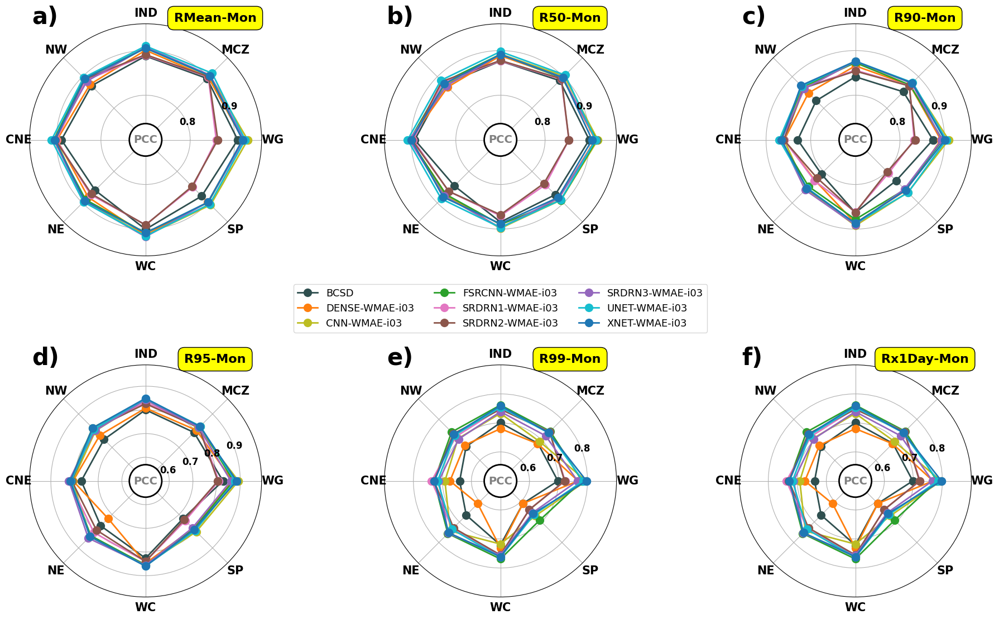

In [75]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from math import pi
from matplotlib.patches import Circle

def plot_radar_plot_tab10(ax=None,
                          csv_file_path='.',
                          varname='varname',
                          label='subplot',
                          ylim=(0.5, 0.8),
                          show_legend=False,
                          metric_name='PCC'):
    
    zones_dict = {
        'WG': 'WESTERN GHATS',
        'MCZ': 'MONSOON CORE ZONE',
        'IND': 'INDIA',
        'NW': 'NORTHWEST',
        'CNE': 'CENTRAL NORTHEAST',
        'NE': 'NORTHEAST',
        'WC': 'WEST CENTRAL',
        'SP': 'SOUTHERN PENINSULA',
    }
    
    # Load the CSV data
    data = pd.read_csv(csv_file_path)
    
    # Get the model names from the CSV file
    model_names = data['EXP_NAME'].values
    radar_values = {model: [] for model in model_names}
    
    # Extract metric values for each model and region
    for zone in zones_dict.keys():
        for i, model in enumerate(model_names):
            radar_values[model].append(data[zones_dict[zone]].values[i])
    
    # Create DataFrame for the radar chart
    radar_data = pd.DataFrame(radar_values, index=zones_dict.keys())
    
    # Number of variables (regions) we're plotting
    num_vars = len(zones_dict)
    
    # Compute the angle of each axis
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    angles += angles[:1]
    
    if ax is None:
        fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))
    
    colors = [
        "#2F4F4F",
        "#ff7f0e",  # Orange pair
        "#bcbd22",  # Yellow-green pair
        "#2ca02c",  # Green pair
        "#e377c2",  # Pink pair
        "#8c564b",  # Brown pair
        "#9467bd",  # Purple pair
        "#17becf",  # Teal pair
         "#1f77b4",  # Blue pair
    ]
     
    
    # Plot each model
    for i, model in enumerate(model_names):
        if model in radar_data.columns:
            values = radar_data[model].tolist()
            values += values[:1]
            ax.plot(angles, values, linewidth=2, linestyle='-', marker='o', markersize=10, label=model,
                    color=colors[i % len(model_names)])
            ax.fill(angles, values, alpha=0, color=colors[i % len(model_names)])
        else:
            print(f"Warning: Model '{model}' not found in radar_data columns.")
    
    # Set xlabels
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(list(zones_dict.keys()), fontsize=15, fontweight='bold')
    
    # Set ylabels
    ax.set_ylim(ylim[0], ylim[1])
    y_ticks = np.arange(ylim[0], ylim[1] + 0.1, 0.1)  # 0.1 increments
    ax.set_yticks(y_ticks[1:-1])

        # Hide default y-tick labels
    ax.set_yticklabels([])

    # Add y-tick labels manually with a high zorder
    for tick in y_ticks[1:-1]:
        ax.text(np.pi / 9, tick, f'{tick:.1f}', ha='center', fontsize=12, fontweight='bold', color='black', zorder=12) 
    
    # Create a white circle at the center
    circle = Circle((0.5, 0.5), 0.07, color='white', ec='black', lw=2, transform=ax.transAxes, zorder=10)
    ax.add_patch(circle)
    
    # Add the metric name on top of the circle
    ax.text(0.5, 0.5, metric_name, ha='center', va='center', color='grey', fontsize=14, fontweight='semibold', transform=ax.transAxes, zorder=11)

    # Add label at the top right of the plot
    ax.text(0.8, 1.01, label, transform=ax.transAxes, ha='center', fontsize=16, fontweight='bold',
            bbox=dict(facecolor='yellow', edgecolor='black', boxstyle='round,pad=0.5'))
    
    # Show legend if specified
    if show_legend:
        ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=3, fontsize=13)
    
    plt.tight_layout()

######################################################################################################################################

metric_name = "PCC"

fig, axs = plt.subplots(nrows=2, ncols=3, figsize=(18, 12), subplot_kw=dict(polar=True))

varname_dict = {
    "RMONMEAN": ["RMean-Mon", (0.74, 1)],
    "R50MON": ["R50-Mon", (0.74, 1)],
    "R90MON": ["R90-Mon", (0.74, 1)],
    "R95MON": ["R95-Mon", (0.5, 0.99)],
    "R99MON": ["R99-Mon", (0.5, 0.9)],
    "RX1DAYMON": ["Rx1Day-Mon", (0.5, 0.9)],
}

DATA_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/CLIMATE_INDICES.L01.I03"
mark_list = ['a)', 'b)', 'c)', 'd)', 'e)', 'f)',]

for i, (ax, (varname, (varlabel, ylim))) in enumerate(zip(axs.flat, varname_dict.items())):
    csv_file_path = f"{DATA_PATH}/P07A_CLIMATE_INDICES_{varname}_{metric_name}_v1.csv"
    plot_radar_plot_tab10(ax=ax, csv_file_path=csv_file_path, varname=varname, ylim=ylim, label=varlabel, show_legend=(varname == 'R50MON'))
    ax.text(0.01, 1, mark_list[i], transform=ax.transAxes, fontsize=30, color='k', fontweight='bold')

# Save and show plot
save_dir = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{save_dir}/Figure_SpiderPlot_ClimIndices_{metric_name}.png', format='png', dpi=400, bbox_inches='tight', facecolor='w', edgecolor='w')
plt.show()

#### Plot the Climate Indices NSE

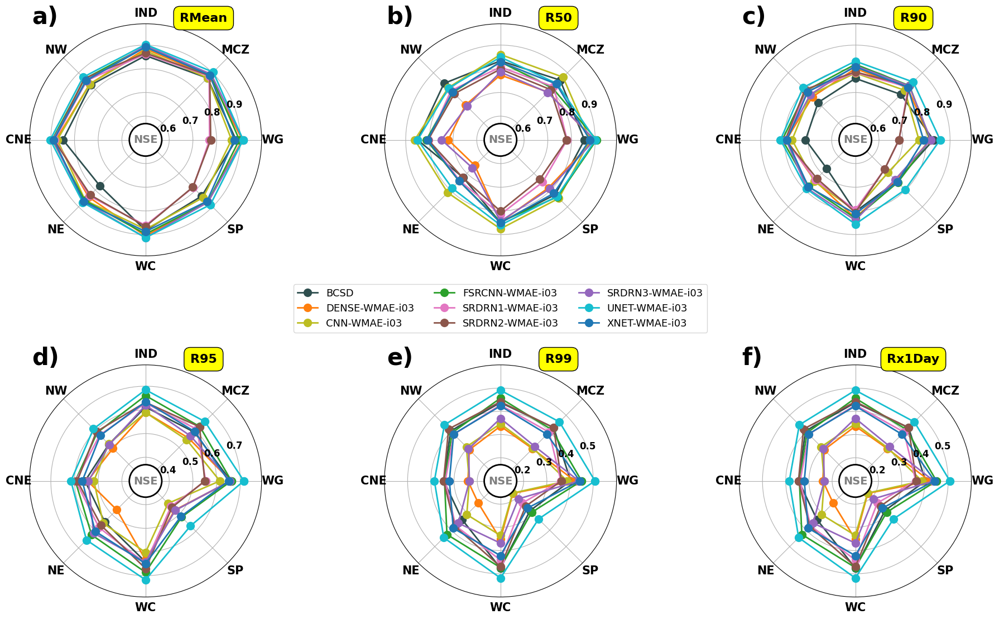

In [79]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from math import pi
from matplotlib.patches import Circle

def plot_radar_plot_tab10(ax=None,
                          csv_file_path='.',
                          varname='varname',
                          label='subplot',
                          ylim=(0.5, 0.8),
                          show_legend=False,
                          metric_name='PCC'):
    
    zones_dict = {
        'WG': 'WESTERN GHATS',
        'MCZ': 'MONSOON CORE ZONE',
        'IND': 'INDIA',
        'NW': 'NORTHWEST',
        'CNE': 'CENTRAL NORTHEAST',
        'NE': 'NORTHEAST',
        'WC': 'WEST CENTRAL',
        'SP': 'SOUTHERN PENINSULA',
    }
    
    # Load the CSV data
    data = pd.read_csv(csv_file_path)
    
    # Get the model names from the CSV file
    model_names = data['EXP_NAME'].values
    radar_values = {model: [] for model in model_names}
    
    # Extract metric values for each model and region
    for zone in zones_dict.keys():
        for i, model in enumerate(model_names):
            radar_values[model].append(data[zones_dict[zone]].values[i])
    
    # Create DataFrame for the radar chart
    radar_data = pd.DataFrame(radar_values, index=zones_dict.keys())
    
    # Number of variables (regions) we're plotting
    num_vars = len(zones_dict)
    
    # Compute the angle of each axis
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    angles += angles[:1]
    
    if ax is None:
        fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))
    
    colors = [
        "#2F4F4F",
        "#ff7f0e",  # Orange pair
        "#bcbd22",  # Yellow-green pair
        "#2ca02c",  # Green pair
        "#e377c2",  # Pink pair
        "#8c564b",  # Brown pair
        "#9467bd",  # Purple pair
        "#17becf",  # Teal pair
         "#1f77b4",  # Blue pair
    ]
     
    
    # Plot each model
    for i, model in enumerate(model_names):
        if model in radar_data.columns:
            values = radar_data[model].tolist()
            values += values[:1]
            ax.plot(angles, values, linewidth=2, linestyle='-', marker='o', markersize=10, label=model,
                    color=colors[i % len(model_names)])
            ax.fill(angles, values, alpha=0, color=colors[i % len(model_names)])
        else:
            print(f"Warning: Model '{model}' not found in radar_data columns.")
    
    # Set xlabels
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(list(zones_dict.keys()), fontsize=15, fontweight='bold')
    
    # Set ylabels
    ax.set_ylim(ylim[0], ylim[1])
    y_ticks = np.arange(ylim[0], ylim[1] + 0.1, 0.1)  # 0.1 increments
    ax.set_yticks(y_ticks[1:-1])

        # Hide default y-tick labels
    ax.set_yticklabels([])

    # Add y-tick labels manually with a high zorder
    for tick in y_ticks[1:-1]:
        ax.text(np.pi / 9, tick, f'{tick:.1f}', ha='center', fontsize=12, fontweight='bold', color='black', zorder=12) 
    
    # Create a white circle at the center
    circle = Circle((0.5, 0.5), 0.07, color='white', ec='black', lw=2, transform=ax.transAxes, zorder=10)
    ax.add_patch(circle)
    
    # Add the metric name on top of the circle
    ax.text(0.5, 0.5, metric_name, ha='center', va='center', color='grey', fontsize=14, fontweight='semibold', transform=ax.transAxes, zorder=11)

    # Add label at the top right of the plot
    ax.text(0.75, 1.01, label, transform=ax.transAxes, ha='center', fontsize=16, fontweight='bold',
            bbox=dict(facecolor='yellow', edgecolor='black', boxstyle='round,pad=0.5'))
    
    # Show legend if specified
    if show_legend:
        ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=3, fontsize=13)
    
    plt.tight_layout()

######################################################################################################################################

metric_name = "NSE"

fig, axs = plt.subplots(nrows=2, ncols=3, figsize=(18, 12), subplot_kw=dict(polar=True))

varname_dict = {
    "RMONMEAN": ["RMean", (0.5, 0.99)],
    "R50MON": ["R50", (0.5, 0.99)],
    "R90MON": ["R90", (0.5, 0.99)],
    "R95MON": ["R95", (0.3, 0.79)],
    "R99MON": ["R99", (0.1, 0.6)],
    "RX1DAYMON": ["Rx1Day", (0.1, 0.6)],
}

DATA_PATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/CLIMATE_INDICES.L01.I03"
mark_list = ['a)', 'b)', 'c)', 'd)', 'e)', 'f)',]

for i, (ax, (varname, (varlabel, ylim))) in enumerate(zip(axs.flat, varname_dict.items())):
    csv_file_path = f"{DATA_PATH}/P07A_CLIMATE_INDICES_{varname}_{metric_name}_v1.csv"
    plot_radar_plot_tab10(ax=ax, csv_file_path=csv_file_path, varname=varname, ylim=ylim, 
                          label=varlabel, show_legend=(varname == 'R50MON'), metric_name=metric_name)
    ax.text(0.01, 1, mark_list[i], transform=ax.transAxes, fontsize=30, color='k', fontweight='bold')

# Save and show plot
save_dir = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS"
# plt.savefig(f'{save_dir}/Figure_SpiderPlot_ClimIndices_{metric_name}.jpg', format='jpg', dpi=400, bbox_inches='tight', facecolor='w', edgecolor='w')
plt.show()

## Plot POD FAR ETS

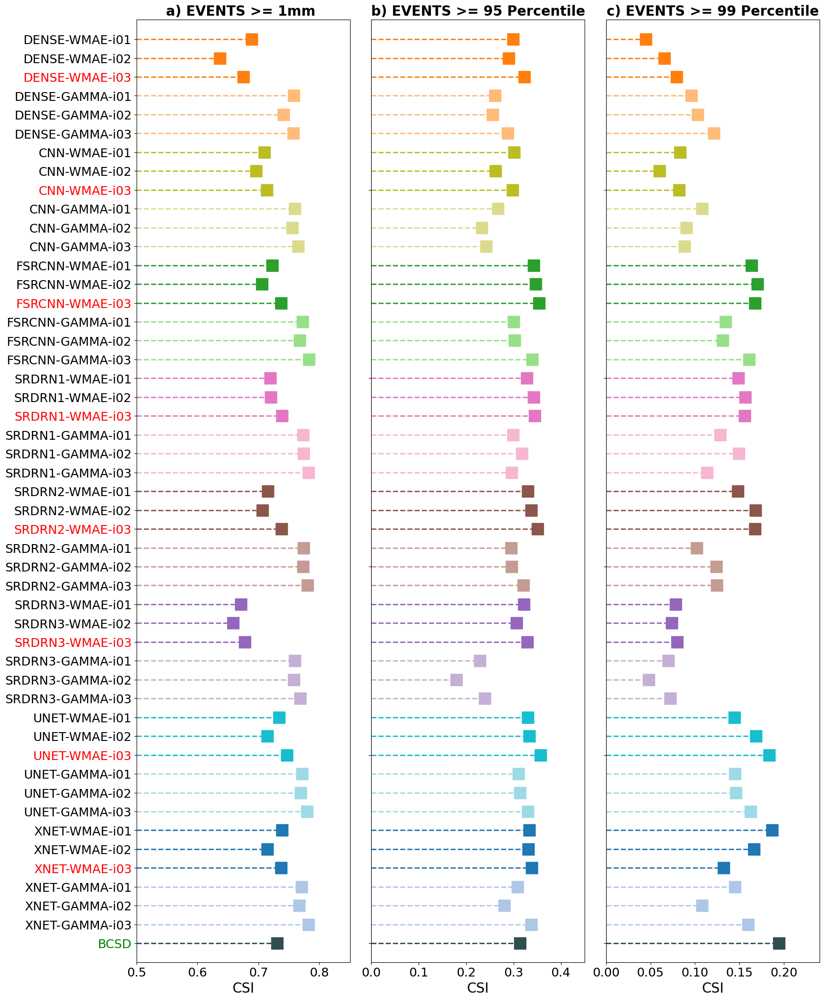

In [86]:
import pandas as pd
import matplotlib.pyplot as plt

def filter_df(df, column, string):
    """Select and merge rows from the dataframe where the specified string is present in the specified column."""
    return df[df[column].str.contains(string, na=False)]

def plot_hstems(ax, df, metric_name="PCC", xlabel=None, xlim=(None, None), title='Metric Markers', yticks_off=False, ref_val=0):
    
    # Reverse the order of rows
    df = df.iloc[::-1]
    
    # Marker colors
    marker_colors = [
        "#2F4F4F",
        "#aec7e8", "#aec7e8", "#aec7e8", "#1f77b4", "#1f77b4", "#1f77b4",  # Blue pair
        "#9edae5", "#9edae5", "#9edae5", "#17becf", "#17becf", "#17becf",  # Teal pair 
        "#c5b0d5", "#c5b0d5", "#c5b0d5", "#9467bd", "#9467bd", "#9467bd",  # Purple pair
        "#c49c94", "#c49c94", "#c49c94", "#8c564b", "#8c564b", "#8c564b",  # Brown pair
        "#f7b6d2", "#f7b6d2", "#f7b6d2", "#e377c2", "#e377c2", "#e377c2",  # Pink pair
        "#98df8a", "#98df8a", "#98df8a", "#2ca02c", "#2ca02c", "#2ca02c",  # Green pair
        "#dbdb8d", "#dbdb8d", "#dbdb8d", "#bcbd22", "#bcbd22", "#bcbd22",  # Yellow-green pair
        "#ffbb78", "#ffbb78", "#ffbb78", "#ff7f0e", "#ff7f0e", "#ff7f0e",  # Orange pair
    ]
    
    ax.grid(False)

    if ref_val is not None:
        ax.axvline(x=ref_val, color='grey', linestyle='--', linewidth=1)

    # Plot stems and markers individually
    for i, (label, value, color) in enumerate(zip(df['LABEL'], df[metric_name], marker_colors)):
        ax.plot([0, value], [i, i], color=color, linewidth=2, linestyle='--', zorder=2)
        ax.plot(value, i, marker='s', markersize=17, color=color, markeredgecolor=color, zorder=2)

    if yticks_off:
        ax.tick_params(axis='y', which='both', labelleft=False)
    else:
        # Set custom y-ticks and labels
        ax.set_yticks(range(len(df)))
        ax.set_yticklabels(df['LABEL'])
        
    # Labels and title
    ax.tick_params(axis='both', labelsize=18)  # Set x tick size
    ax.set_xlabel(metric_name if xlabel is None else xlabel, fontsize=20, fontweight='normal')
    ax.set_title(title, fontsize=20, fontweight='bold')
    ax.set_xlim(xlim[0], xlim[1])
   
    # Change the color of ytick if label is "WMAE-i03"
    for label in ax.get_yticklabels():
        if "WMAE-i03" in label.get_text():
            label.set_color("red")
        if "BCSD" in label.get_text():
            label.set_color("green")

    ax.set_ylim(-1, len(df) + 0.05)
#####################################################################################################
# File paths and loading data
DPATH = "/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA"

fig, axs = plt.subplots(1, 3, figsize=(18, 25), gridspec_kw={'wspace': 0.1, 'hspace': 0.15}) 

# Load and filter data
df1 = pd.read_csv(f'{DPATH}/TABLE_EVALMETRICS_BINARY_METRICS_IND_A1MM_v1.csv')
df2 = pd.read_csv(f'{DPATH}/TABLE_EVALMETRICS_BINARY_METRICS_IND_A95P_v1.csv')
df3 = pd.read_csv(f'{DPATH}/TABLE_EVALMETRICS_BINARY_METRICS_IND_A99P_v1.csv')
df1 = filter_df(df1, column='ZONE_NAME', string="INDIA")

# Plotting with markers
plot_hstems(axs[0], df1, metric_name="CSI", title='a) EVENTS >= 1mm ', xlim=(0.5, 0.85))
plot_hstems(axs[1], df2, metric_name="CSI", title='b) EVENTS >= 95 Percentile', xlim=(0, 0.45), yticks_off=True)
plot_hstems(axs[2], df3, metric_name="CSI", title='c) EVENTS >= 99 Percentile', xlim=(0, 0.24), yticks_off=True)

SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'


# plt.savefig(f'{SAVE_DIR}/Figure_CSI_StemPlots.png', format='png', dpi=400, bbox_inches='tight', facecolor='w', edgecolor='w')
plt.show()


## Plot the Boxplot Regional

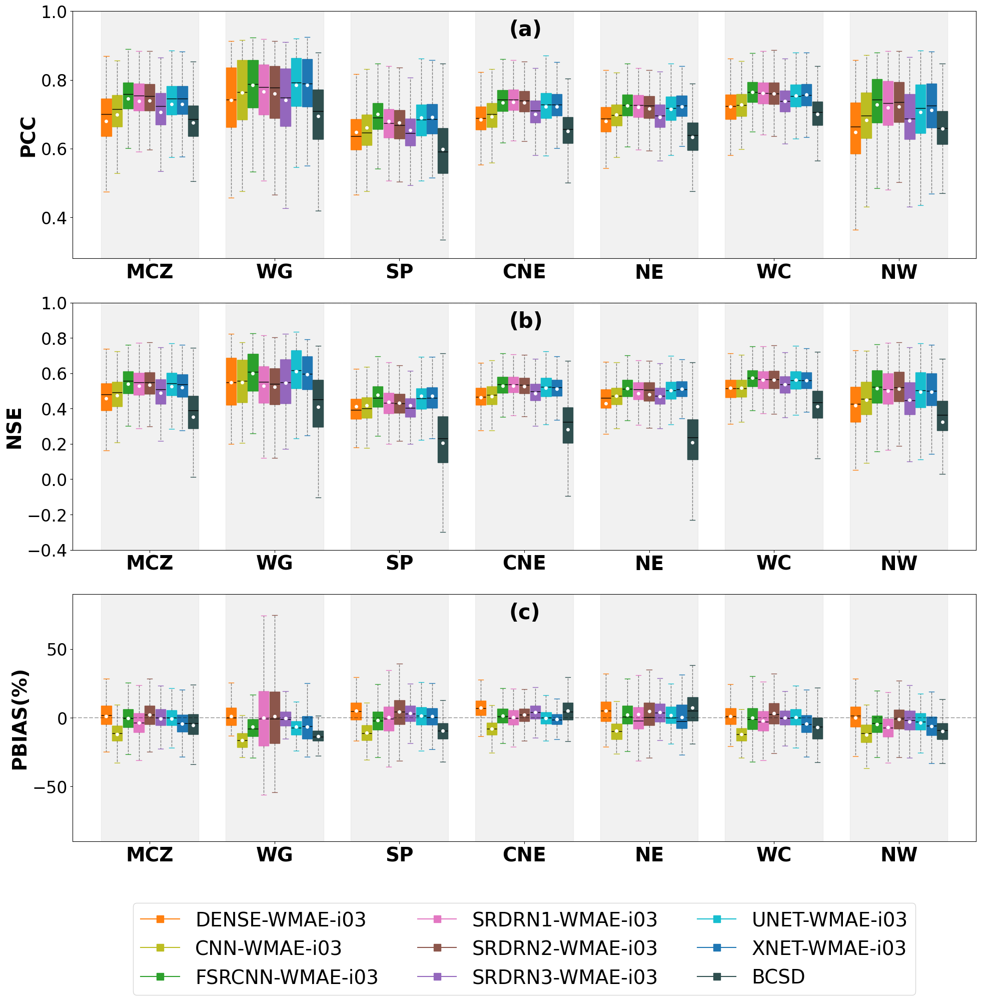

In [68]:
import pandas as pd
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

def custom_masker(mask_path, data_ds, model_id, metric_name='KGE'):
    """Mask an xarray dataarray"""
    dataarray = data_ds[f'{model_id}_{metric_name}'].squeeze()
    maskarray = xr.open_dataset(mask_path).mask.squeeze()
    
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape != maskarray.shape:
        raise ValueError("dataarray and maskarray must have the same shape")
        
    masked_array = (dataarray * maskarray).data.flatten()
    masked_array = masked_array[~np.isnan(masked_array)]
    return masked_array

def plot_multibar(data_ds, data_dict, zones_dict, metric_name='KGE', metric_label='KGE', best_val_line=None, ylim=(None, None), 
                  show_legend=False, ax=None):
    # Load and mask data for each zone and model
    data_load = {zone: pd.DataFrame({model_label: custom_masker(zone_mask_path, data_ds, model_id, metric_name) 
                                     for model_id, model_label in data_dict.items()}) 
                 for zone, (zone_mask_path, zone_label) in zones_dict.items()}
    
    # Extract the data into a format suitable for boxplotting
    boxplot_data = []
    positions = []
    pos = 0
    zone_labels = []
    
    for zone in zones_dict.keys():
        for model in data_dict.keys():
            boxplot_data.append(data_load[zone][data_dict[model]])
            positions.append(pos)
            pos += 0.16
        zone_labels.append((positions[-len(data_dict)] + positions[-1]) / 2)  # Position the zone label in the middle of the models
        pos += 0.4  # Add extra space between different zones

    if ax is None:
        fig, ax = plt.subplots(figsize=(20, 4))
        
    # Define colors for each model
    # colors = plt.get_cmap('tab10', len(data_dict))
    # colors = ["#ffbb78","#dbdb8d","#98df8a","#f7b6d2","#c49c94","#c5b0d5","#9edae5","#aec7e8","#2F4F4F"]

    colors = [
        "#ff7f0e",  # Orange pair
        "#bcbd22",  # Yellow-green pair
        "#2ca02c",  # Green pair
        "#e377c2",  # Pink pair
        "#8c564b",  # Brown pair
        "#9467bd",  # Purple pair
        "#17becf",  # Teal pair
        "#1f77b4",  # Blue pair
        "#2F4F4F",
    ]

    # Shade background for intermittent x-tick groups
    for i in range(0, len(positions), len(data_dict)):
        start_pos = positions[i] - 0.08
        end_pos = positions[i + len(data_dict) - 1] + 0.08
        ax.axvspan(start_pos, end_pos, color='lightgrey', alpha=0.3)
    
    # Create the boxplots
    for i, (data, position) in enumerate(zip(boxplot_data, positions)):
        ax.boxplot(data, positions=[position], showfliers=False, widths=0.15, patch_artist=True,
                   showmeans=True,
                   boxprops=dict(facecolor=colors[i % len(data_dict)], color=colors[i % len(data_dict)]),
                   capprops=dict(color=colors[i % len(data_dict)]),
                   whiskerprops=dict(visible=True,  linestyle='--', alpha=0.5),
                   flierprops=dict(markeredgecolor=colors[i % len(data_dict)]),
                   medianprops=dict(color='black'),
                   meanprops=dict(marker='o', markerfacecolor='white', markeredgecolor=colors[i % len(data_dict)]))

    
    # Customize the plot
    ax.set_ylabel(metric_label, fontsize=20, fontweight="semibold")
    ax.tick_params(axis='y', labelsize=24)
    ax.tick_params(axis='x', labelsize=24)
    ax.set_ylim(ylim[0], ylim[1])
    
    # Set x-ticks and labels
    ax.set_xticks(zone_labels)
    ax.set_xticklabels(zones_dict.keys(), rotation=0, fontsize=28, fontweight='bold')
    ax.set_ylabel(metric_label, fontsize=28, fontweight='bold')
    
    # Add a legend for the models
    handles = [plt.Line2D([0], [0], color=colors[i], marker='s', markersize=10, markerfacecolor=colors[i], 
                          label=model) for i, model in enumerate(data_dict.values())]

    if show_legend:
        ax.legend(handles=handles, loc='upper center', fontsize=28, ncol=3, bbox_to_anchor=(0.5, -0.21))
    if best_val_line is not None:
        ax.axhline(y=best_val_line, color='k', linestyle='--', alpha=0.3)

#######################################################################################################################

# Create a 4x1 grid of subplots
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(20, 20))

MASK_PATH = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES'
zones_dict = {
     # 'IND': [f'{MASK_PATH}/India.nc', 'INDIA'], 
    'MCZ': [f'{MASK_PATH}/Monsoon_Core_Zone.nc', 'MONSOON CORE ZONE'], 
    'WG' : [f'{MASK_PATH}/Western_Ghats.nc' , 'WESTERN GHATS'], 
    'SP' : [f'{MASK_PATH}/South_Peninsular.nc' , 'SOUTHERN PENINSULA'], 
    'CNE': [f'{MASK_PATH}/Central_Northeast.nc', 'CENTRAL NORTHEAST'], 
    'NE' : [f'{MASK_PATH}/Northeast.nc' , 'NORTHEAST'], 
    'WC' : [f'{MASK_PATH}/West_Central.nc' , 'WEST CENTRAL'], 
    'NW' : [f'{MASK_PATH}/Northwest.nc' , 'NORTHWEST'], 
}

index_dict = {

    'N01_L01_I03': 	'DENSE-WMAE-i03', 
    'N02_L01_I03': 	'CNN-WMAE-i03', 
    'N03_L01_I03': 	'FSRCNN-WMAE-i03',  
    'S01_L01_I03': 	'SRDRN1-WMAE-i03', 
    'S02_L01_I03': 	'SRDRN2-WMAE-i03', 
    'S03_L01_I03': 	'SRDRN3-WMAE-i03',  
    'U01_L01_I03': 	'UNET-WMAE-i03', 
    'U02_L01_I03': 	'XNET-WMAE-i03', 
    'C01'        :  'BCSD',
    
}


data_ds = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/EVAL_METRICS_SPATIAL_v1.nc')

# Plotting
plot_multibar(data_ds, index_dict, zones_dict, metric_name='PCC', metric_label='PCC', best_val_line=1, ylim=(0.28, 1), show_legend=False, ax=axs[0])
plot_multibar(data_ds, index_dict, zones_dict, metric_name='NSE', metric_label='NSE', best_val_line=1, ylim=(-0.4, 1), show_legend=False, ax=axs[1])
plot_multibar(data_ds, index_dict, zones_dict, metric_name='PBIAS', metric_label='PBIAS(%)',  best_val_line=0, ylim=(-90, 90), show_legend=True, ax=axs[2])

# Add labels for each subplot
mark_list = ['(a)', '(b)', '(c)']
for i, mark in enumerate(mark_list):
    axs[i].text(0.483, 0.9, mark, transform=axs[i].transAxes, fontsize=30, color='k', fontweight='bold')

# Adjust layout
plt.tight_layout(h_pad=2)


SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'

plt.savefig(f'{save_dir}/Figure_MultiBox_/Plot_Zones.png', format='png', dpi=400, bbox_inches='tight', facecolor='w', edgecolor='w')
plt.show()

## Plot Training Curves

In [ ]:
import os
import numpy as np
import xarray as xr
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from matplotlib.ticker import MultipleLocator

def list_files(directory):
    file_dict = {}
    for filename in os.listdir(directory):
        if os.path.isfile(os.path.join(directory, filename)):
            key = filename[:3].upper()
            file_dict[key] = os.path.join(directory, filename)

    # Return a dictionary sorted by keys
    return dict(sorted(file_dict.items()))

def plot_traincurve(ax, csv_path, label, loss_head='TLOSS', ylim=None):
    
    df = pd.read_csv(csv_path)
    
    ax.set_facecolor('#F0F0F0')  
    # ax.grid(True)

    if loss_head=='LOSS':
        ax.plot(df['epoch'], df['val_loss'], linewidth=4, color='orange', label = 'Validation Set')
        ax.plot(df['epoch'], df['loss'], linewidth=4, color='blue', label = 'Training Set')
    
    elif loss_head=='MAE':
        ax.plot(df['epoch'], df['val_mean_absolute_error'], linewidth=4, color='orange', label = 'Validation Set')
        ax.plot(df['epoch'], df['mean_absolute_error'], linewidth=4, color='blue', label = 'Training Set')

    elif loss_head=='MSE':
        ax.plot(df['epoch'], df['val_mean_squared_error'], linewidth=4, color='orange', label = 'Validation Set')
        ax.plot(df['epoch'], df['mean_squared_error'], linewidth=4, color='blue', label = 'Training Set') 

    else:
        raise ValueError('Invalid choice of loss_head. Avail options are LOSS, MAE, MSE')
        
    # Find the index of the minimum val_loss
    min_val_loss_idx = df['val_loss'].idxmin()
    min_val_loss_epoch = df.at[min_val_loss_idx, 'epoch']
    min_val_loss_value = df.at[min_val_loss_idx, 'val_loss']
    
    # Annotate the lowest val_loss point with a star marker
    # ax.scatter(min_val_loss_epoch, min_val_loss_value, color='green', s=1000, marker='*', zorder=5)
    ax.axvline(x = min_val_loss_epoch, color='green', linewidth = 2, linestyle='--', label='Best Model')
    
    # Set tick parameters
    ax.tick_params(axis='both', which='major', labelsize=20)
    ax.set_xlabel('epochs', fontsize = 18)
    
    ax.set_ylabel(loss_head, fontsize = 18)
    
    if not ylim is None:
        ax.set_ylim(ylim[0], ylim[1])

    ax.text(0.82, 0.85, 
        label, 
        transform=ax.transAxes, ha='center', va='center', 
        fontsize=23, fontweight='bold', 
        color='k', backgroundcolor=None, bbox=None)

exp_dict = {
    'F01': 'SRDRN-NN',
    'F02': 'SRDRN-BL',
    'F03': 'SRDRN-BC',
    'F04': 'SRDRN-TC',
    'F05': 'SRDRN-PS',
    'F06': 'SRDRN-D1',
    'F07': 'SRDRN-D2',
    'F08': 'SRDRN-D3',
    'F09': 'SRDRN-F1',
    'F10': 'SRDRN-F2',
    'F11': 'SRDRN-F3',
}

# Specify the directory path
directory_path = '/home/midhunm/AI4KLIM/EXPMNTS/P03A_SRDRN_Downscaling/ANALYSE/DATA_2PLOT/TRAINLOGS'

# List all files in the directory and assign to a dictionary
files_dict = list_files(directory_path)

# Update file_paths with values from exp_dict
for key in files_dict:
    files_dict[key] = {'csv_path': files_dict[key], 'label': exp_dict[key]}

# Create a new figure and get the axes objects for each subplot
fig = plt.figure(figsize=(20, 30))

# Create a 2x2 grid for subplots using GridSpec
gs = GridSpec(6, 2, hspace=0.5)

# First subplot (top-left)
ax01 = fig.add_subplot(gs[0, 0])
ax02 = fig.add_subplot(gs[0, 1])
ax03 = fig.add_subplot(gs[1, 0])
ax04 = fig.add_subplot(gs[1, 1])
ax05 = fig.add_subplot(gs[2, 0])
ax06 = fig.add_subplot(gs[2, 1])
ax07 = fig.add_subplot(gs[3, 0])
ax08 = fig.add_subplot(gs[3, 1])
ax09 = fig.add_subplot(gs[4, 0])
ax10 = fig.add_subplot(gs[4, 1])
ax11 = fig.add_subplot(gs[5, 0])
axes = [ax01, ax02, ax03, ax04, ax05, ax06, ax07, ax08, ax09, ax10, ax11]

loss_head = 'MAE'
ylim=(0.08, 0.42)

for i, (exp_id, values) in enumerate(files_dict.items()):
    
    csv_path, label = values['csv_path'], values['label']
    # print(f'\nLoading ... {exp_id}: {label}\n\t{csv_path}')

    plot_traincurve(axes[i], csv_path=csv_path, label=label, loss_head=loss_head, ylim=ylim)

axes[-1].legend(loc = 'upper center', fontsize = 32, bbox_to_anchor=(1.7, 1))

SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P03A_SRDRN_Downscaling/ANALYSE/RESULTS'
# plt.savefig(f'{SAVE_DIR}/FigXX_LearningCurve_{loss_head.upper()}.jpg', format='jpg', dpi=400, bbox_inches='tight',facecolor='w', edgecolor='w')
plt.show()

## Conditional Bias Series

### Generate Data

In [56]:
import xarray as xr
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def mask_array(dataarray, maskarray):
    """Mask an xarray dataarray"""
    if isinstance(maskarray, xr.DataArray):
        maskarray = maskarray.values
    if dataarray.shape[1:2] != maskarray.shape[1:2]:
        raise ValueError("dataarray and maskarray must have the same shape")
    return dataarray * maskarray

#############################################################################################
DPATH = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/GENDATA'

mask = xr.open_dataset('/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/MASKFILES/Monsoon_Core_Zone.nc')

# List of model filenames

model_filenames = {
    'C01':         [f'{DPATH}/c01_quantile_mapping_disagregated_out.nc',    'BCSD'    ],
    'N01_L01_I03': [f'{DPATH}/p07a_n01_l01_i03_b01_r01_012_out.nc', 'DENSE-WMAE-i03'],
    'N02_L01_I03': [f'{DPATH}/p07a_n02_l01_i03_b01_r01_012_out.nc', 'CNN-WMAE-i03'],
    'N03_L01_I03': [f'{DPATH}/p07a_n03_l01_i03_b01_r01_012_out.nc', 'FSRCNN-WMAE-i03'],
    'S01_L01_I03': [f'{DPATH}/p07a_s01_l01_i03_b01_r01_012_out.nc', 'SRDRN1-WMAE-i03'],
    'S02_L01_I03': [f'{DPATH}/p07a_s02_l01_i03_b01_r01_012_out.nc', 'SRDRN2-WMAE-i03'],
    'S03_L01_I03': [f'{DPATH}/p07a_s03_l01_i03_b01_r01_012_out.nc', 'SRDRN3-WMAE-i03'],
    'U01_L01_I03': [f'{DPATH}/p07a_u01_l01_i03_b01_r01_012_out.nc', 'UNET-WMAE-i03'],
    'U02_L01_I03': [f'{DPATH}/p07a_u02_l01_i03_b01_r01_012_out.nc', 'XNET-WMAE-i03'],
}


# Load observation dataset
obs_data = xr.open_dataset(f'{DPATH}/ref_imda_012_data.nc')
obs_precip = mask_array(obs_data['prec'], mask['mask']).values.flatten()

# Define precipitation rate categories (bins)
precip_bins = [1, 5, 25, 50, 100, 150, np.nanmax(obs_precip)]  # Example bins in mm/day

# Initialize a dictionary to store conditional bias values for each model
conditional_bias_models = {}

# Calculate conditional bias for each model
for (exp_id, (model_filename, label)) in model_filenames.items():
    print(f'Calculating .. {exp_id}: {label}')
    model_data = xr.open_dataset(model_filename)
    model_precip = mask_array(model_data['prec'], mask['mask']).values.flatten()
    
    # Initialize a dictionary to store conditional bias values for each category
    conditional_bias_category = {}
    
    # Calculate conditional bias for each precipitation rate category
    for i in range(len(precip_bins) - 1):
        lower_bound = precip_bins[i]
        upper_bound = precip_bins[i + 1]

        # Select data within the current precipitation rate category for observation
        obs_subset = obs_precip[
            (obs_precip >= lower_bound) & (obs_precip < upper_bound)
        ]

        # Calculate mean precipitation values for observation
        obs_mean = np.nanmean(obs_subset)

        # Calculate conditional bias for the current category
        conditional_bias_category[f'{lower_bound} - {upper_bound} mm/day'] = np.nanmean(model_precip[
            (model_precip >= lower_bound) & (model_precip < upper_bound)
        ]) / obs_mean if obs_mean > 0 else np.nan
    
    # Store the conditional bias values for the current model
    conditional_bias_models[label] = conditional_bias_category

# Convert the conditional_bias_models dictionary to a DataFrame
df = pd.DataFrame(conditional_bias_models)

# Save the DataFrame to a CSV file
SAVE_DIR = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA'
csv_file_path = f'{SAVE_DIR}/P07A_TEST_EVAL_CB_SERIES_DATA_v1.0.0.csv'  # Replace with your desired file path
df.to_csv(csv_file_path, index_label='Precipitation Rate Category')

print(f'Data saved to: {csv_file_path}')


Calculating .. C01: BCSD
Calculating .. N01_L01_I03: DENSE-WMAE-i03
Calculating .. N02_L01_I03: CNN-WMAE-i03
Calculating .. N03_L01_I03: FSRCNN-WMAE-i03
Calculating .. S01_L01_I03: SRDRN1-WMAE-i03
Calculating .. S02_L01_I03: SRDRN2-WMAE-i03
Calculating .. S03_L01_I03: SRDRN3-WMAE-i03


/tmp/ipykernel_6850/1699106039.py:67: RuntimeWarning: Mean of empty slice
  conditional_bias_category[f'{lower_bound} - {upper_bound} mm/day'] = np.nanmean(model_precip[


Calculating .. U01_L01_I03: UNET-WMAE-i03
Calculating .. U02_L01_I03: XNET-WMAE-i03
Data saved to: /home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/P07A_TEST_EVAL_CB_SERIES_DATA_v1.0.0.csv


## Plot the Series

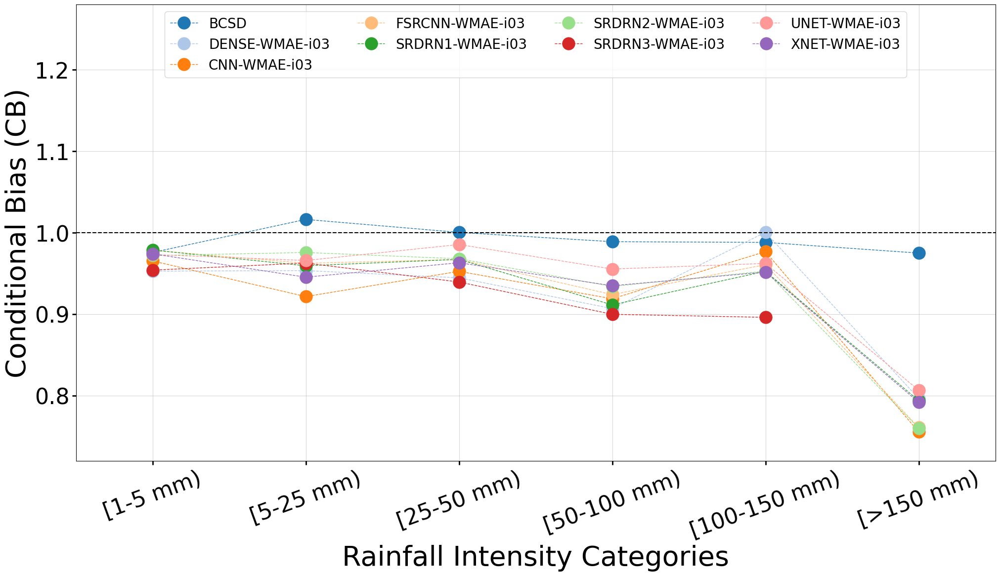

In [58]:
marker = 'o'
markersize = 18
xlabelsize = 40
ylabelsize = 40

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
from matplotlib.ticker import MultipleLocator

model_filenames = {
    'C01': [f'{DPATH}/c01_quantile_mapping_disagregated_out.nc',    'BCSD'    ],
    'N01_L01_I03': [f'{DPATH}/p07a_n01_l01_i03_b01_r01_012_out.nc', 'DENSE-WMAE-i03'],
    'N02_L01_I03': [f'{DPATH}/p07a_n02_l01_i03_b01_r01_012_out.nc', 'CNN-WMAE-i03'],
    'N03_L01_I03': [f'{DPATH}/p07a_n03_l01_i03_b01_r01_012_out.nc', 'FSRCNN-WMAE-i03'],
    'S01_L01_I03': [f'{DPATH}/p07a_s01_l01_i03_b01_r01_012_out.nc', 'SRDRN1-WMAE-i03'],
    'S02_L01_I03': [f'{DPATH}/p07a_s02_l01_i03_b01_r01_012_out.nc', 'SRDRN2-WMAE-i03'],
    'S03_L01_I03': [f'{DPATH}/p07a_s03_l01_i03_b01_r01_012_out.nc', 'SRDRN3-WMAE-i03'],
    'U01_L01_I03': [f'{DPATH}/p07a_u01_l01_i03_b01_r01_012_out.nc', 'UNET-WMAE-i03'],
    'U02_L01_I03': [f'{DPATH}/p07a_u02_l01_i03_b01_r01_012_out.nc', 'XNET-WMAE-i03'],
}

# Colors
colors = sns.color_palette("tab20", 12)

# Create a 2x2 grid for subplots using GridSpec
gs = GridSpec(1, 1, wspace=0.20, hspace=0.35)

# Create a new figure and get the axes objects for each subplot
fig = plt.figure(figsize=(24, 12))
ax02 = fig.add_subplot(gs[0, 0])

DPATH = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA'
conditional_bias_models = pd.read_csv(f'{DPATH}/P07A_TEST_EVAL_CB_SERIES_DATA_v1.0.0.csv')

# Plotting
categories = ['[1-5 mm)', '[5-25 mm)', '[25-50 mm)', '[50-100 mm)', '[100-150 mm)', '[>150 mm)']

ax = ax02

for i, (exp_id, (model_filename, label)) in enumerate(model_filenames.items()):
    ax.plot(categories, list(conditional_bias_models[label]),
              color=colors[i], marker=marker, markersize=markersize, linewidth=1, linestyle='--', label=label)

ax.axhline(y=1, color='k', linestyle='--', label=None)
ax.set_xlabel('Rainfall Intensity Categories', fontweight='normal', fontsize=xlabelsize)
ax.set_ylabel('Conditional Bias (CB)', fontsize=ylabelsize)
ax.set_xticks(np.arange(len(categories)))
ax.set_xticklabels(categories, fontweight='normal', fontsize=32, ha='center')
ax.tick_params(axis='x', rotation=20, which='both', length=6, width=2, labelsize=32)
ax.tick_params(axis='y', rotation=0, which='both', length=6, width=2, labelsize=32)

ax.legend(fontsize=20, ncols=4, loc='upper center')
ax.grid(True, alpha=0.5)
ax.set_ylim(0.72, 1.28)
ax.set_xlim(-0.5, len(categories) - 0.5)

# Save or display the plot
spath = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/RESULTS'
# plt.savefig(f'{spath}/FigXX_Conditiona_Bias_Series.jpg', format='jpg', dpi=400, bbox_inches='tight')
plt.show()


# Archive

## Figure: Multiple Bar Plots

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

def plot_bar_plot(ax=None,
                  what_metric='KGE',
                  ylim=(0, 1),
                  csv_file_path='.',
                  cmap='viridis',
                  add_legend = False,
                ):  # Added cmap parameter

    zones_dict = {
        'IND': 'INDIA', 
        'MCZ': 'MONSOON CORE ZONE', 
        'HIM': 'THE HIMALAYAS', 
        'WG': 'WESTERN GHATS', 
        'SP': 'SOUTHERN PENINSULA', 
        'CNE': 'CENTRAL NORTHEAST', 
        'NE': 'NORTHEAST', 
        'WC': 'WEST CENTRAL', 
        'NW': 'NORTHWEST', 
    }
    
    data_load = {}
    
    # Load each CSV file into the dictionary
    for zone, zone_label in zones_dict.items():
        df = pd.read_csv(csv_file_path)
        data_load[zone] = df[df['ZONE'] == zone]
    
    # Get the model names from one of the CSV files
    model_names = data_load[list(zones_dict.keys())[0]]['LABEL'].values
    
    # Extract the Metric values for each model
    metric_values = {model: [] for model in model_names}
    for zone in zones_dict.keys():
        for i, model in enumerate(model_names):
            metric_values[model].append(data_load[zone][what_metric]['EXP_ID'].str.contains('I01|C01').values[i])
    
    # Create a DataFrame for easier plotting
    sel_df = pd.DataFrame(metric_values, index=zones_dict.keys())
    print(sel_df.head())

    if ax is None:
        # Create a multi-bar plot for KGE values
        fig, ax = plt.subplots(figsize=(14, 3))
    ax.set_facecolor('white')
    # ax.grid(True)

    bar_width = 0.08
    
    index = pd.Series(range(len(zones_dict)))
    
    # Generate colors from the specified colormap
    cmap = plt.get_cmap(cmap)
    colors = cmap(np.linspace(0, 1, len(model_names)))
    
    # Plot each model's KGE values across the zones
    for i, model in enumerate(model_names):
        ax.bar(index + i * bar_width, sel_df[model], bar_width, label=model, color=colors[i])
        
    # Add labels, title, and legend
    ax.set_ylabel(what_metric, fontsize=15)
    ax.set_ylim(ylim[0], ylim[1])
    ax.set_xticks(index + bar_width * (len(model_names) - 1) / 2)
    ax.set_xticklabels(zones_dict.keys(), rotation=0, fontsize=16, fontweight='bold')
    ax.tick_params(axis='y', labelsize=12, width=2, direction='in', pad=10)

    if add_legend:
    
        legend = ax.legend(loc='upper center', fontsize=10, title='METHODS', title_fontproperties={'weight': 'bold'}, 
                           ncol=1, bbox_to_anchor=(1.1, 0.93))
        # legend.get_frame().set_facecolor('lightgrey')
        legend.get_frame().set_edgecolor('black')
    
    # Display the plot
    plt.tight_layout()
    plt.show()

In [31]:
# Usage

plot_bar_plot(what_metric='NSE',
              ylim=(0.15, 0.77),
              cmap='tab10',
              csv_file_path="/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/TABLE_EVALMETRICS_v1.0.0.csv",
             )
              

KeyError: 'EXP_ID'

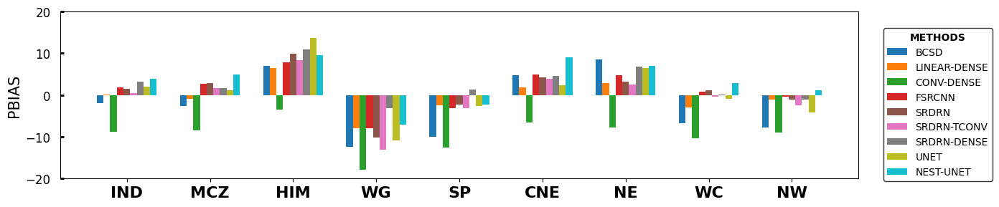

In [78]:
plot_bar_plot(what_metric='PBIAS',
              ylim=(-20, 20),
              cmap='tab10',
              csv_file_path='/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/TABLE_EVALMETRICS_v1.0.0.csv',
             )

## Figure: Radar Chart

In [28]:
import pandas as pd
import matplotlib.pyplot as plt
from math import pi

def plot_radar_plot(ax=None,
                    what_metric='KGE',
                    ylim=(0, 0.79),
                    csv_file_path="."):

    zones_dict = {
        'IND': 'INDIA', 
        'MCZ': 'MONSOON CORE ZONE', 
        'HIM': 'THE HIMALAYAS', 
        'WG': 'WESTERN GHATS', 
        'SP': 'SOUTHERN PENINSULA', 
        'CNE': 'CENTRAL NORTHEAST', 
        'NE': 'NORTHEAST', 
        'WC': 'WEST CENTRAL', 
        'NW': 'NORTHWEST', 
    }
    
    data_load = {}
    
    # Load each CSV file into the dictionary
    for zone, zone_label in zones_dict.items():
        df = pd.read_csv(csv_file_path)
        data_load[zone] = df[df['ZONE'] == zone]
    
    # Get the model names from one of the CSV files
    model_names = data_load[list(zones_dict.keys())[0]]['LABEL'].values
    
    # Extract the KGE values for each model
    metric_values = {model: [] for model in model_names}
    for zone in zones_dict.keys():
        for i, model in enumerate(model_names):
            metric_values[model].append(data_load[zone][what_metric].values[i])

    # Create a DataFrame for the radar chart
    radar_data = pd.DataFrame(metric_values, index=zones_dict.keys())
    
    # Number of variables we're plotting
    num_vars = len(zones_dict)
    
    # Compute angle of each axis
    angles = [n / float(num_vars) * 2 * pi for n in range(num_vars)]
    angles += angles[:1]
    
    if ax is None:
        # Initialise the radar chart
        fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))
    
    # Plot each individual model
    for model in model_names:
        if model in radar_data.columns:
            values = radar_data[model].values.flatten().tolist()
            values += values[:1]  # Repeat the first value to close the loop
            ax.plot(angles, values, linewidth=2, linestyle='solid', marker='o', label=model)
            ax.fill(angles, values, alpha=0.1)
        else:
            print(f"Warning: Model '{model}' not found in radar_data columns.")
    
    # Add labels and title
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(list(zones_dict.values()), fontsize=14, fontweight='bold')
    ax.set_yticks([0.2, 0.4, 0.6, 0.8])
    ax.set_yticklabels(['0.2', '0.4', '0.6', '0.8'], fontsize=12, fontweight='bold')
    ax.set_ylim(ylim[0], ylim[1])
    
    # Title inside the plot
    title_text = 'RADAR CHART'
    if title_text:
        ax.text(0.5, 1.1, title_text, transform=ax.transAxes, ha='center', fontsize=16, fontweight='bold',
                bbox=dict(facecolor='lightgreen', edgecolor='black', boxstyle='round,pad=0.5'))
    
    # Adjust legend placement
    ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=3, fontsize=12)
    
    # Display the plot
    plt.tight_layout()
    plt.show()


In [29]:
plot_radar_plot(what_metric='NSE', 
                ylim=(0, 0.8),
                csv_file_path='/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/PLTDATA/TABLE_EVALMETRICS_v1.0.0.csv',
               )

ValueError: Length of values (27) does not match length of index (9)

## Figure: boxplot of NSE, PCC, RMSE

## Figure: Spider Plot of Climate Indices

## Figure: Conditional Bias Series

In [ ]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt

dpath = '/home/midhunm/AI4KLIM/EXPMNTS/P07A_DeepDown_Comparison/ANALYSE/GENDATA'

# Load observation dataset
obs_data = xr.open_dataset(f'{dpath}/IMDRF_025_PREC_2000_2021_JJAS.nc')

# Extract observation precipitation data array and flatten it
obs_precip = obs_data['prec'].values.flatten()

# Define precipitation rate categories (bins)
precip_bins = [0.1, 2.5, 7.6, 35.6, 64.5, 124.5, 244.5, np.nanmax(obs_precip)]  # Example bins in mm/day

# Initialize a dictionary to store conditional bias values for each model
conditional_bias_models = {}

# List of model filenames
model_filenames = {
    'BCSD' : 'QBCSD_025_PREC_2000_2021_JJAS.nc',
    'SRResNet' : 'SRNET_025_PREC_2000_2021_JJAS.nc',
    'SRGAN-MSE' : 'SGMSE_025_PREC_2000_2021_JJAS.nc',
    'SRGAN-VGGB2' : 'SB2C2_025_PREC_2000_2021_JJAS.nc',
    'SRGAN-VGGB3' : 'SB3C4_025_PREC_2000_2021_JJAS.nc',
    'SRGAN-VGGB4' : 'SB4C4_025_PREC_2000_2021_JJAS.nc',
    }

p07a_c01_qmsd_012_out.nc
p07a_c02_qdmsd_012_out.nc
p07a_n01_l01_i01_b01_r01_012_out.nc
p07a_n01_l01_i02_b01_r01_012_out.nc
p07a_n01_l01_i03_b01_r01_012_out.nc
p07a_n02_l01_i01_b01_r01_012_out.nc
p07a_n02_l01_i02_b01_r01_012_out.nc
p07a_n02_l01_i03_b01_r01_012_out.nc
p07a_n03_l01_i01_b01_r01_012_out.nc
p07a_n03_l01_i02_b01_r01_012_out.nc
p07a_n03_l01_i03_b01_r01_012_out.nc
p07a_ref_imda_012_data.nc


# Calculate conditional bias for each model
for (label, model_filename) in model_filenames.items():
    model_data = xr.open_dataset(f'{dpath}/{model_filename}')
    model_precip = model_data['prec'].values.flatten()
    
    # Initialize a dictionary to store conditional bias values for each category
    conditional_bias_category = {}
    
    # Calculate conditional bias for each precipitation rate category
    for i in range(len(precip_bins) - 1):
        lower_bound = precip_bins[i]
        upper_bound = precip_bins[i + 1]

        # Select data within the current precipitation rate category for observation
        obs_subset = obs_precip[
            (obs_precip >= lower_bound) & (obs_precip < upper_bound)
        ]

        # Calculate mean precipitation values for observation
        obs_mean = np.nanmean(obs_subset)

        # Calculate conditional bias for the current category
        conditional_bias_category[f'{lower_bound} - {upper_bound} mm/day'] = np.nanmean(model_precip[
            (model_precip >= lower_bound) & (model_precip < upper_bound)
        ]) / obs_mean if obs_mean > 0 else np.nan
    
    # Store the conditional bias values for the current model
    conditional_bias_models[model_filename] = conditional_bias_category

# Create a bar plot of conditional bias values for all models
categories = ['VLR','LR','MR','RHR','HR','VHR','EHR']#list(conditional_bias_models[model_filenames['BCSD']].keys())
plt.figure(figsize=(12, 8))

plt.axhline(y=1, color='k', linestyle='--', label='Reference (CB = 1)')

for (label, model_filename) in model_filenames.items():
    plt.plot(categories, list(conditional_bias_models[model_filename].values()), 
             marker='o',markersize=10, linewidth=1, linestyle='--',
             label=label)

plt.xlabel('Rainfall Intensity Categories', fontweight='normal', fontsize = 20)
plt.ylabel('Conditional Bias (CB)', fontsize = 20)
# plt.title('Conditional Bias Comparison of Different Methods (vs. Observation)', fontsize = 20)
plt.xticks(categories, rotation=0, fontweight='normal', fontsize = 20, ha='center')
plt.yticks(fontsize = 20, fontweight='normal',)
plt.legend(fontsize=20)
plt.grid(True, alpha=0.5)
plt.tight_layout()
spath = '/home/midhunm/AI4KLIM/EXPMNTS/P01A_SRGAN_Downscaling/REVISE1/RESULTS'
plt.savefig(f'{spath}/FigXX_CondBias_IND.jpg', format='jpg', dpi=300, bbox_inches='tight')
plt.show()
